# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [114]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [115]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [116]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [117]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [118]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [119]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat([x.float(), y.float()], 1)
    #### END CODE HERE ####
    return combined

In [120]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [121]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [122]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [123]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [124]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [125]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.275585190176964, discriminator loss: 0.24280166755244137


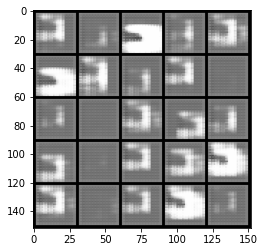

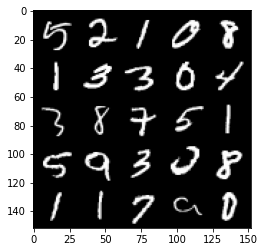

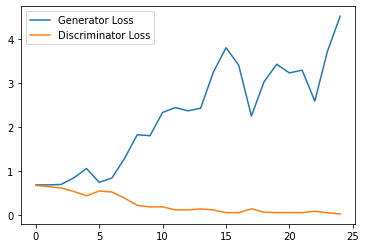

Step 1000: Generator loss: 4.457714499950409, discriminator loss: 0.029119938066229225


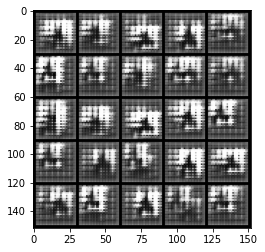

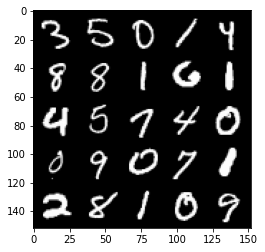

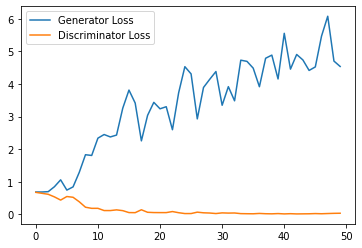

Step 1500: Generator loss: 4.473234662532806, discriminator loss: 0.052030836947262286


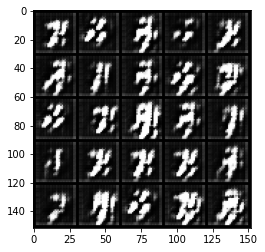

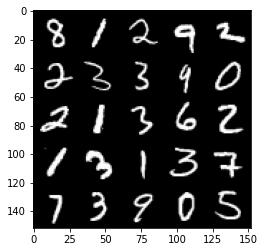

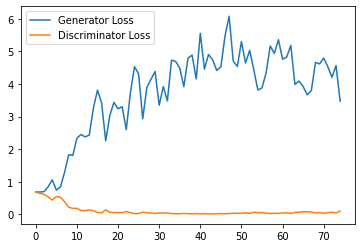

Step 2000: Generator loss: 3.3570314984321596, discriminator loss: 0.13108628483116627


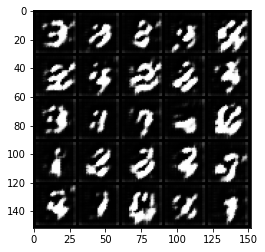

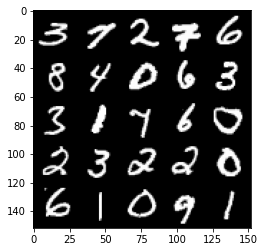

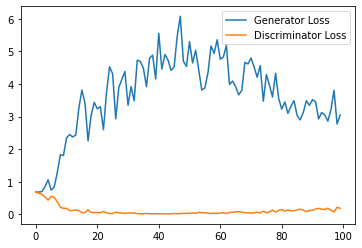

Step 2500: Generator loss: 2.7758297443389894, discriminator loss: 0.19986170530319214


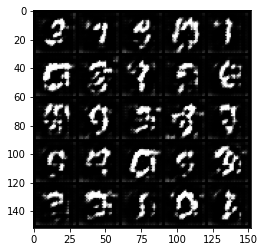

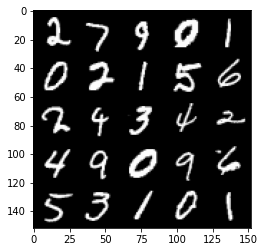

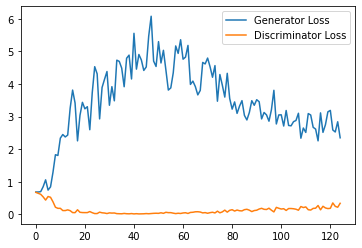

Step 3000: Generator loss: 2.49875089263916, discriminator loss: 0.23390835878252983


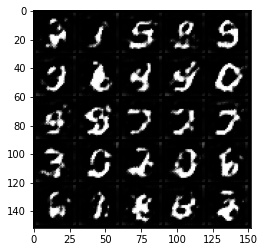

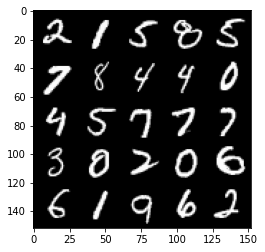

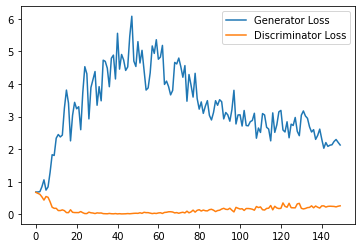

Step 3500: Generator loss: 2.3277946977615356, discriminator loss: 0.26989278008043766


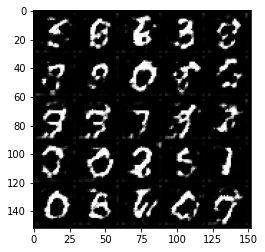

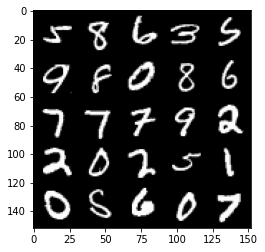

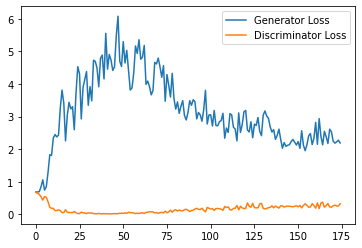

Step 4000: Generator loss: 2.2892826035022735, discriminator loss: 0.2883744756579399


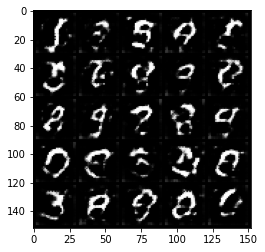

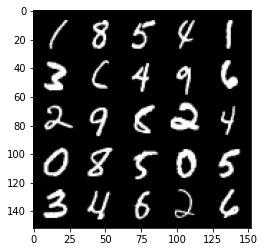

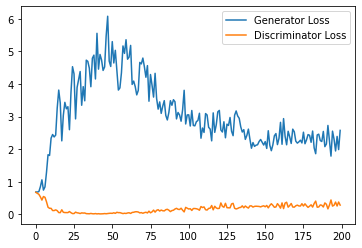

Step 4500: Generator loss: 2.112940435171127, discriminator loss: 0.33590423959493637


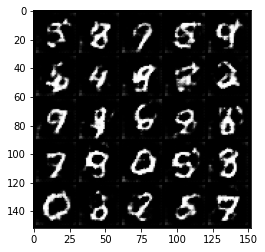

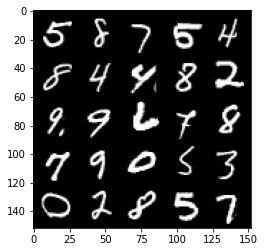

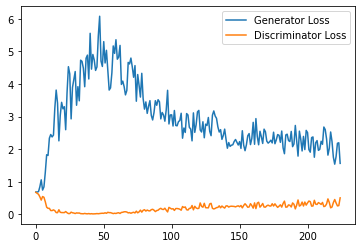

Step 5000: Generator loss: 2.026439650774002, discriminator loss: 0.34645085358619687


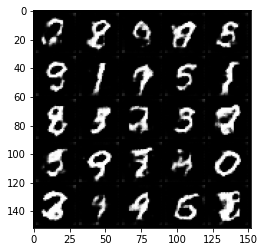

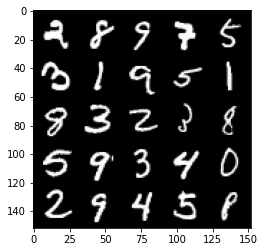

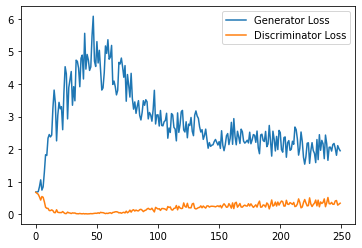

Step 5500: Generator loss: 1.874531016111374, discriminator loss: 0.38648043394088744


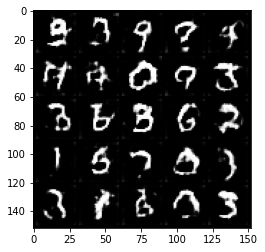

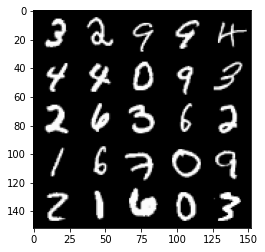

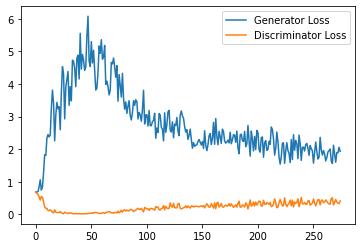

Step 6000: Generator loss: 1.8912834992408754, discriminator loss: 0.38938368928432465


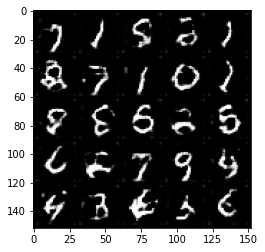

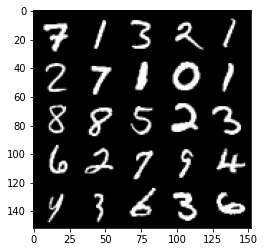

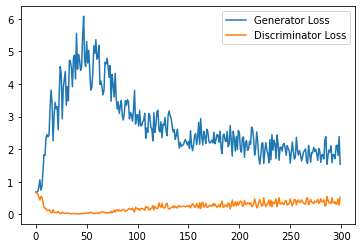

Step 6500: Generator loss: 1.6919073803424836, discriminator loss: 0.4137333086133003


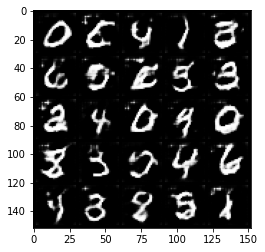

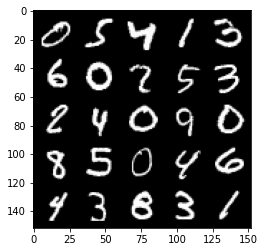

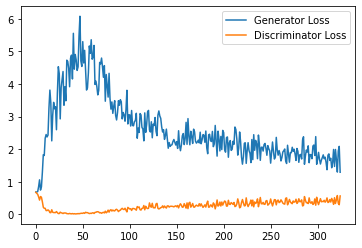

Step 7000: Generator loss: 1.5764143371582031, discriminator loss: 0.4401565499305725


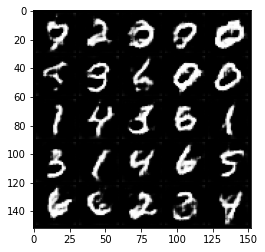

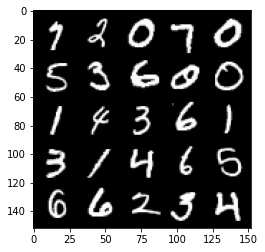

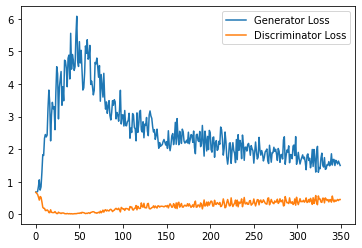

Step 7500: Generator loss: 1.5345347998142242, discriminator loss: 0.45755693602561953


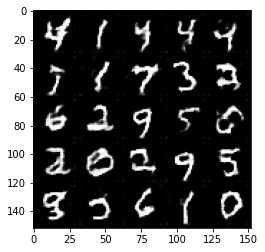

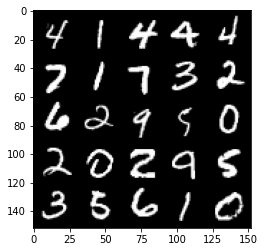

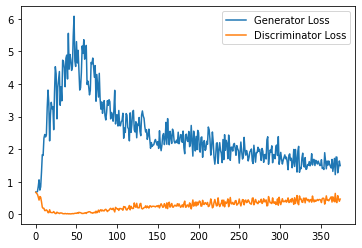

Step 8000: Generator loss: 1.5154819669723512, discriminator loss: 0.47806085523962977


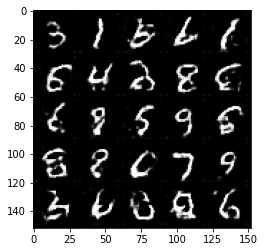

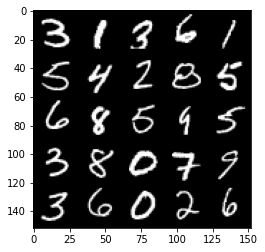

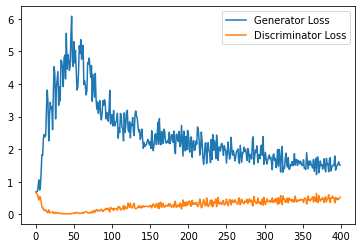

Step 8500: Generator loss: 1.4007373725175858, discriminator loss: 0.4989708491563797


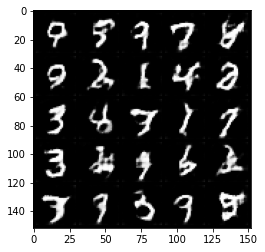

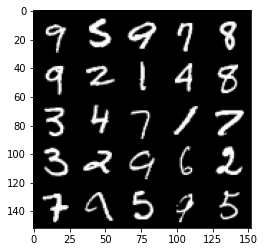

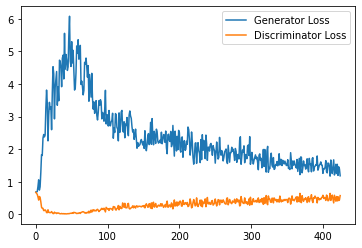

Step 9000: Generator loss: 1.3978714780807495, discriminator loss: 0.48817599534988404


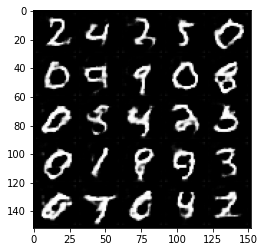

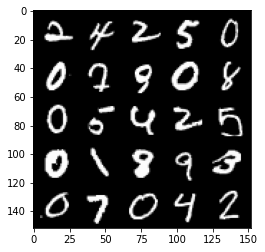

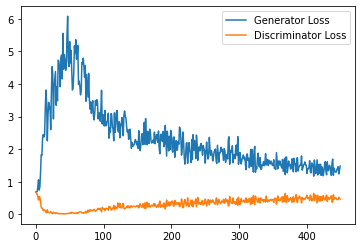

Step 9500: Generator loss: 1.3824023168087005, discriminator loss: 0.5052041271328926


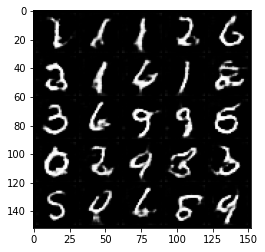

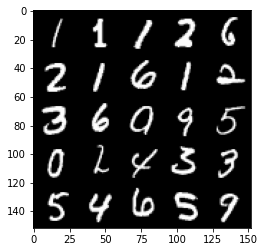

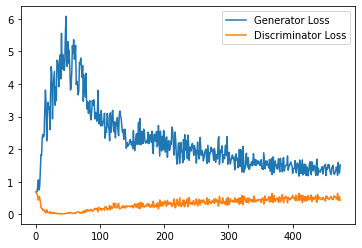

Step 10000: Generator loss: 1.3121941384077072, discriminator loss: 0.5010709576010705


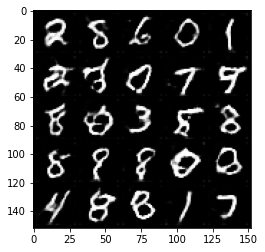

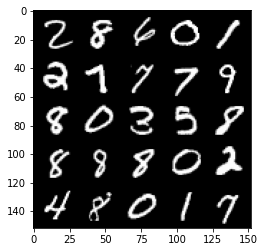

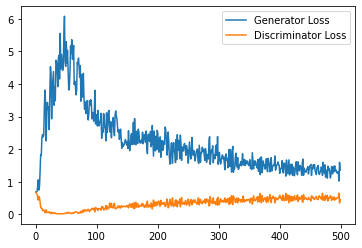

Step 10500: Generator loss: 1.2695997413396836, discriminator loss: 0.5125964108705521


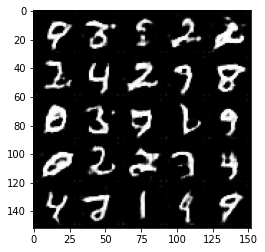

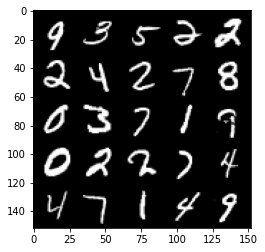

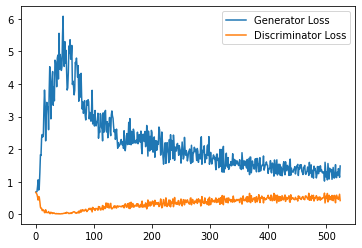

Step 11000: Generator loss: 1.2702919298410416, discriminator loss: 0.5204238756299019


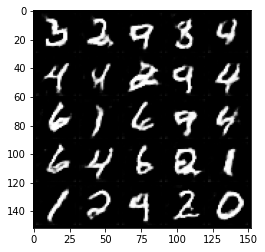

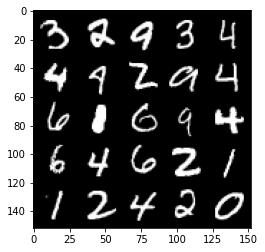

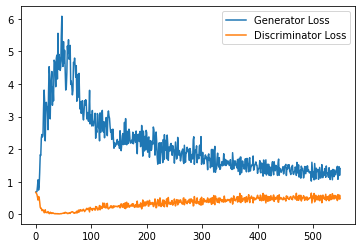

Step 11500: Generator loss: 1.305666749715805, discriminator loss: 0.5300550537109375


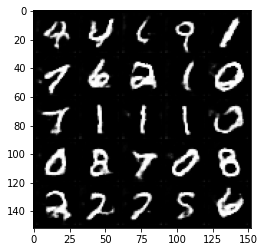

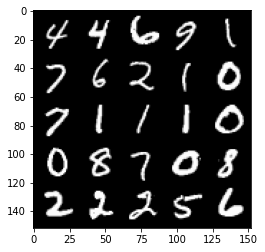

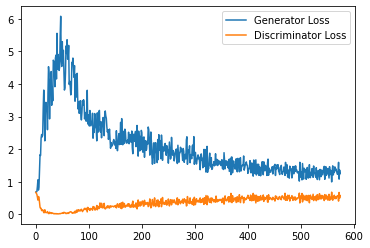

Step 12000: Generator loss: 1.2603850671052932, discriminator loss: 0.5286437611579895


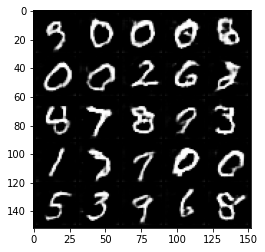

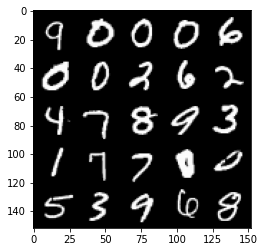

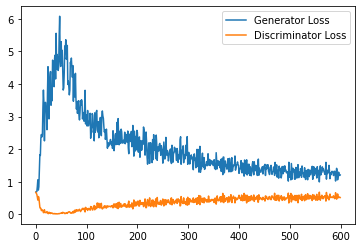

Step 12500: Generator loss: 1.2272360070943833, discriminator loss: 0.5324800782203675


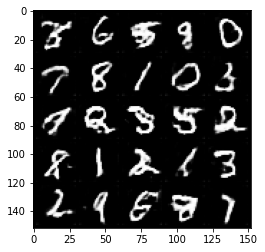

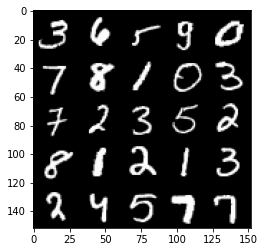

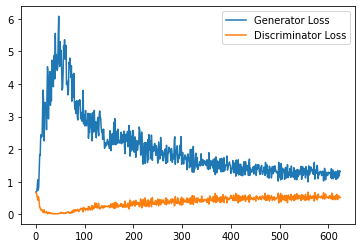

Step 13000: Generator loss: 1.2068606641292572, discriminator loss: 0.5471806108951569


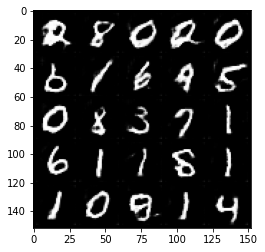

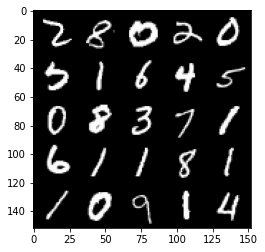

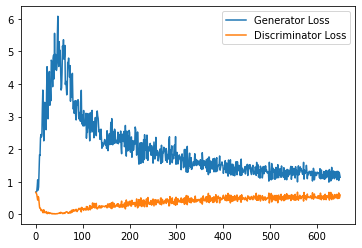

Step 13500: Generator loss: 1.2084377040863037, discriminator loss: 0.5554784659147263


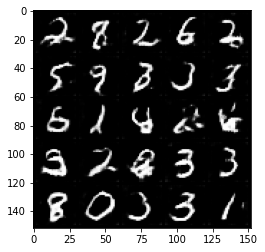

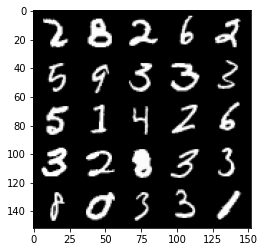

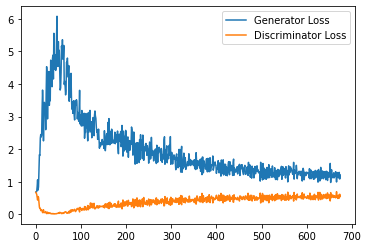

Step 14000: Generator loss: 1.1800607051849366, discriminator loss: 0.5528444310426712


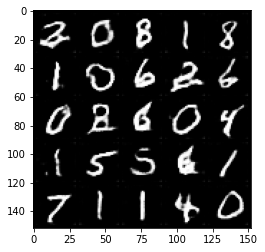

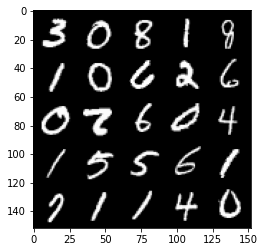

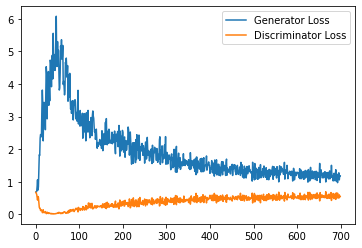

Step 14500: Generator loss: 1.1507921993732453, discriminator loss: 0.5634991552233696


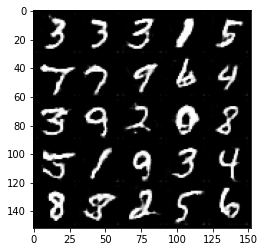

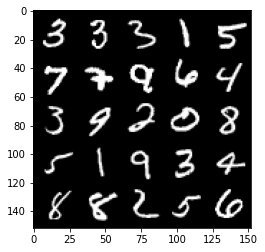

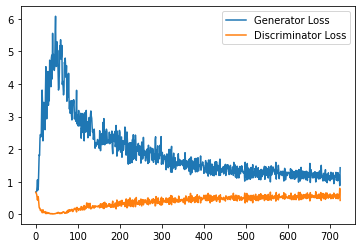

Step 15000: Generator loss: 1.163744549512863, discriminator loss: 0.5572226922512055


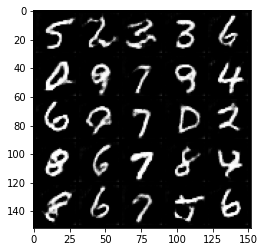

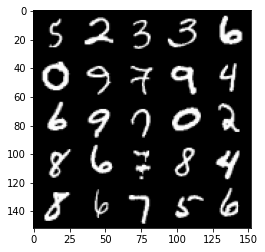

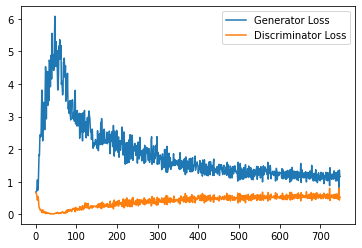

Step 15500: Generator loss: 1.128086471557617, discriminator loss: 0.5632283251285553


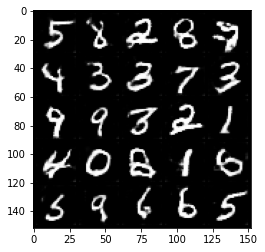

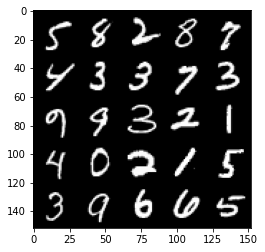

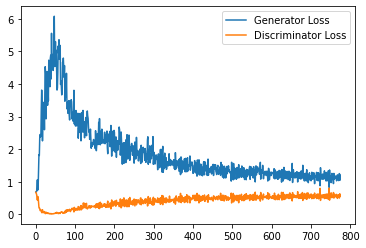

Step 16000: Generator loss: 1.148382069826126, discriminator loss: 0.5690092828869819


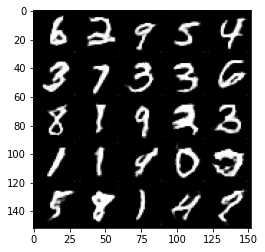

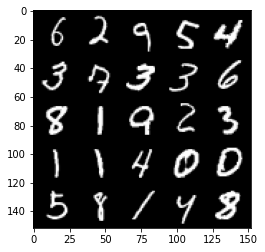

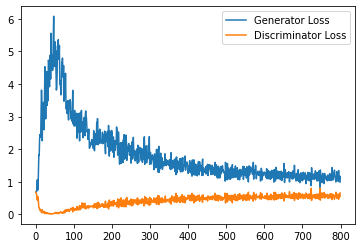

Step 16500: Generator loss: 1.153271666288376, discriminator loss: 0.5645613604784012


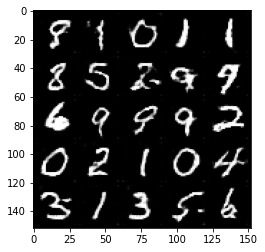

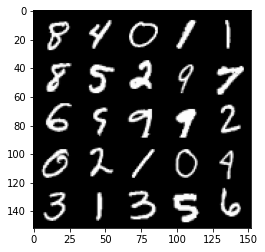

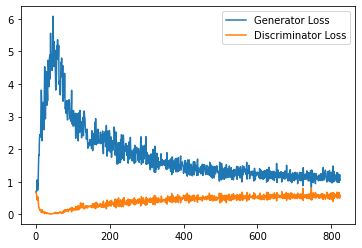

Step 17000: Generator loss: 1.1264188160896302, discriminator loss: 0.5612309062480927


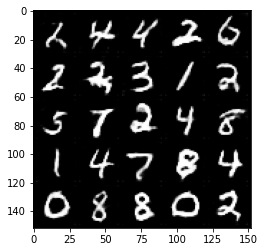

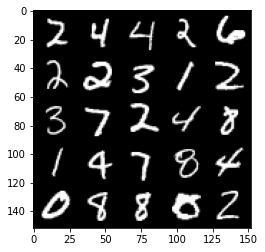

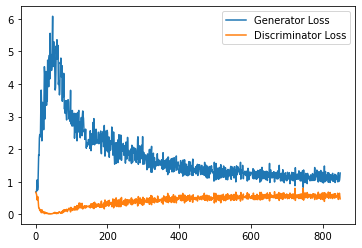

Step 17500: Generator loss: 1.0837435902357102, discriminator loss: 0.5767457801103592


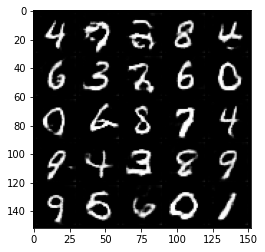

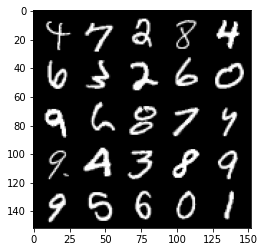

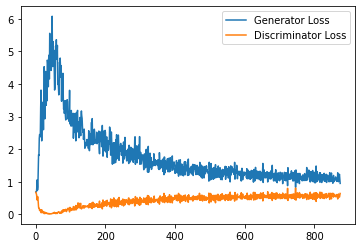

Step 18000: Generator loss: 1.1006912655830383, discriminator loss: 0.5688190286159516


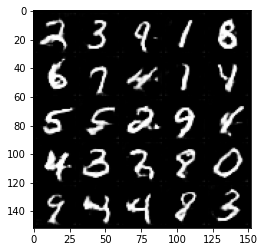

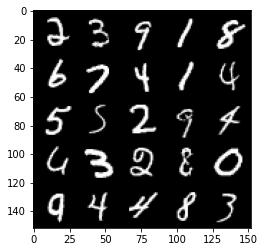

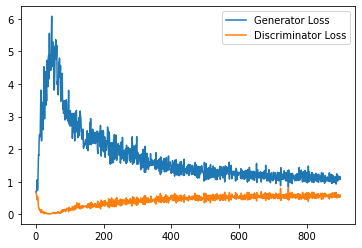

Step 18500: Generator loss: 1.0879001302719116, discriminator loss: 0.5765083147883415


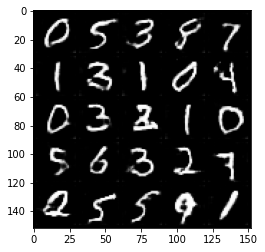

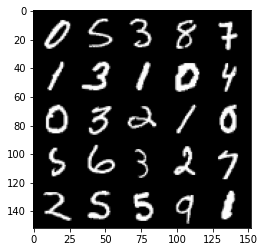

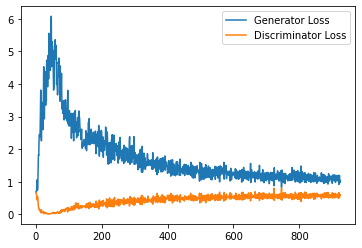

Step 19000: Generator loss: 1.0657837060689925, discriminator loss: 0.5726047986745835


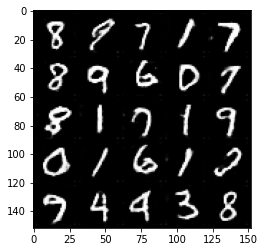

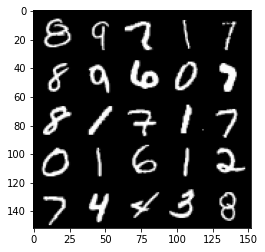

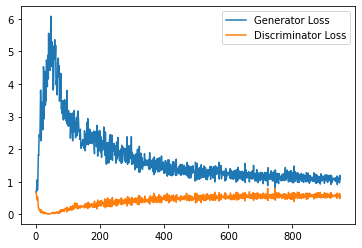

Step 19500: Generator loss: 1.0839647660255431, discriminator loss: 0.5782484779953957


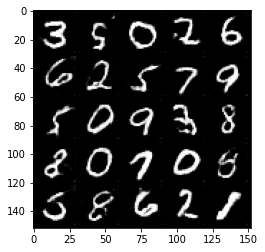

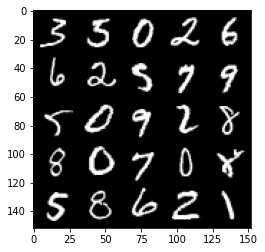

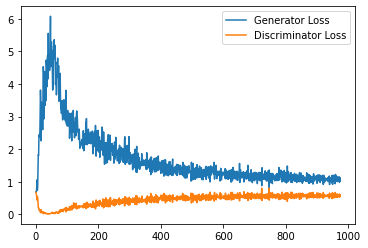

Step 20000: Generator loss: 1.0827691102027892, discriminator loss: 0.5824494809508324


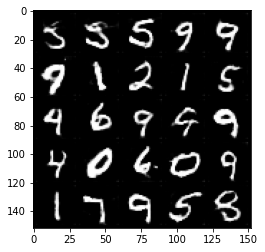

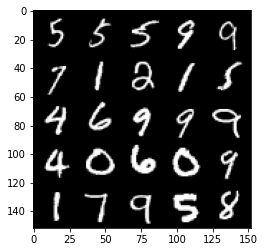

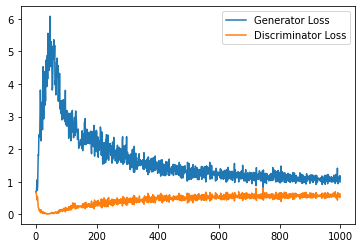

Step 20500: Generator loss: 1.0850176684856414, discriminator loss: 0.5843927904367446


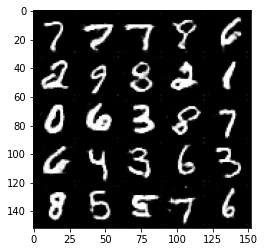

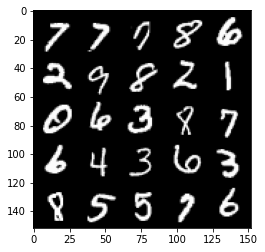

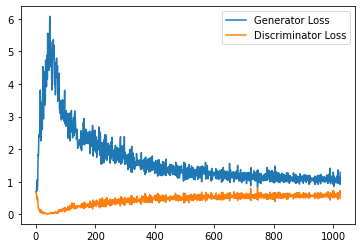

Step 21000: Generator loss: 1.0570605047941208, discriminator loss: 0.5802195303440094


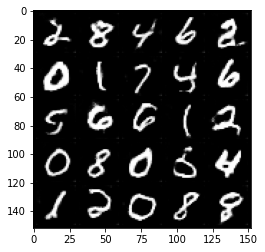

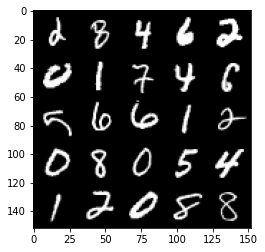

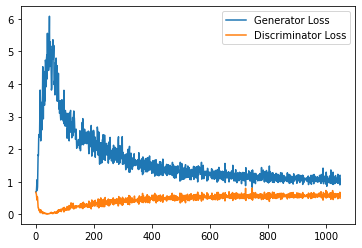

Step 21500: Generator loss: 1.0381416718959808, discriminator loss: 0.580714949131012


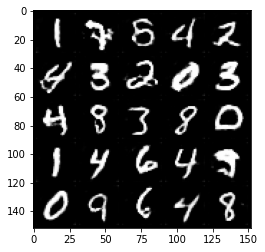

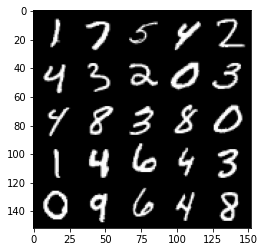

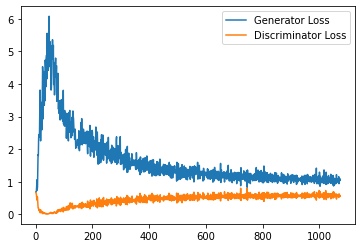

Step 22000: Generator loss: 1.0304975345134735, discriminator loss: 0.5785618753433227


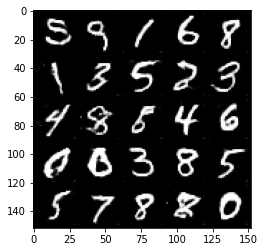

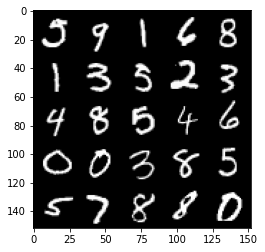

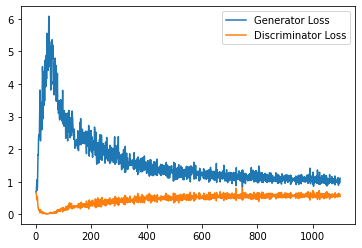

Step 22500: Generator loss: 1.035625832915306, discriminator loss: 0.5860139585137367


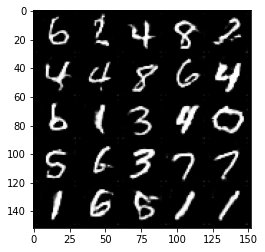

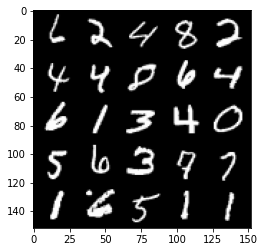

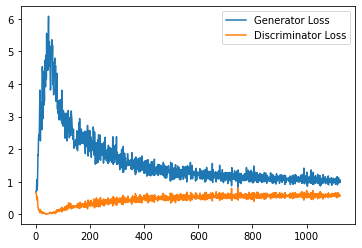

Step 23000: Generator loss: 1.0676822453737258, discriminator loss: 0.5819773115515708


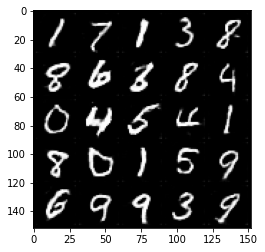

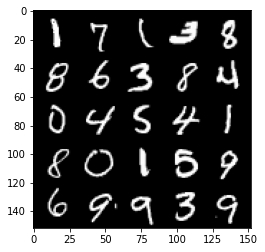

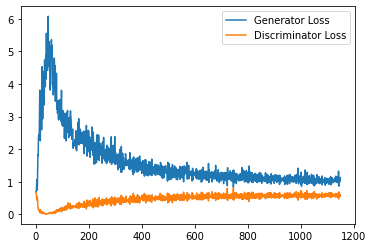

Step 23500: Generator loss: 1.0427212612628938, discriminator loss: 0.5789957107901573


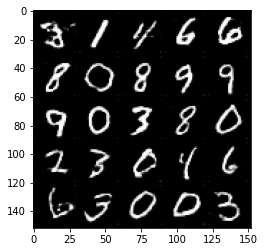

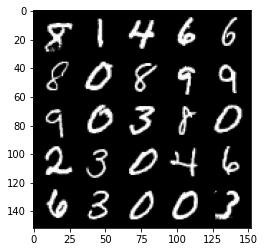

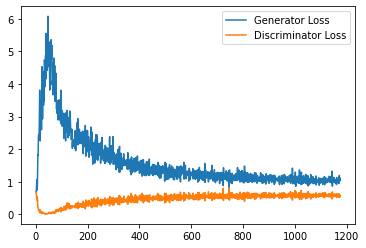

Step 24000: Generator loss: 1.0612745287418366, discriminator loss: 0.5894587577581406


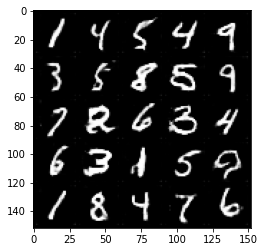

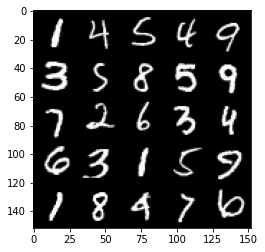

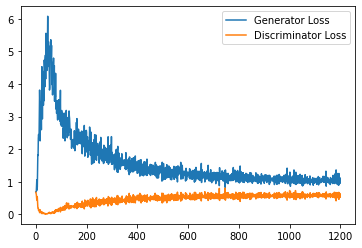

Step 24500: Generator loss: 1.0201984827518462, discriminator loss: 0.5872933000326157


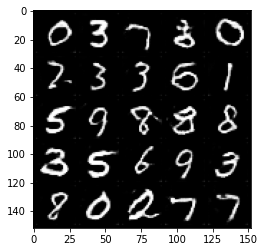

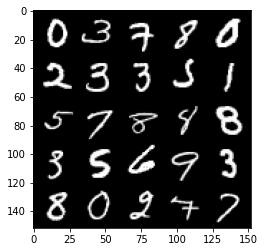

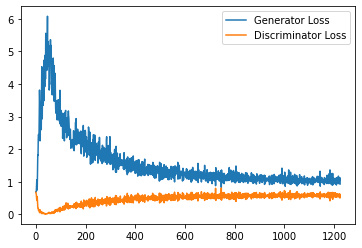

Step 25000: Generator loss: 0.9935137723684311, discriminator loss: 0.5884376661777496


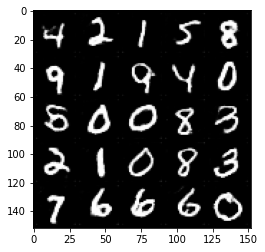

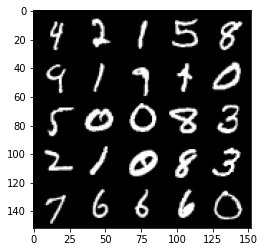

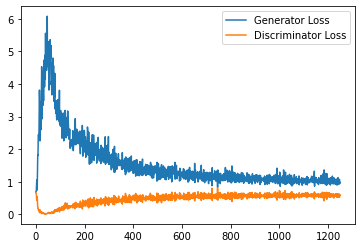

Step 25500: Generator loss: 1.0239028557538987, discriminator loss: 0.586570412993431


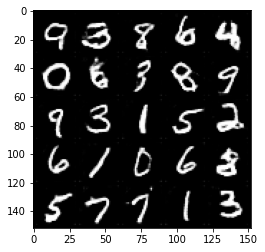

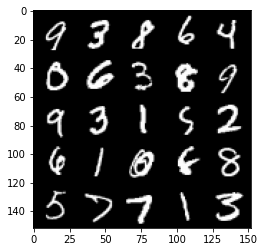

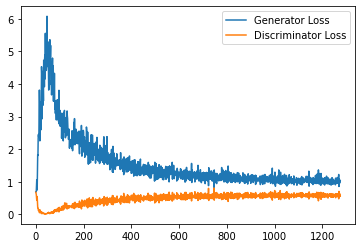

Step 26000: Generator loss: 1.0100908910036086, discriminator loss: 0.5891204543113708


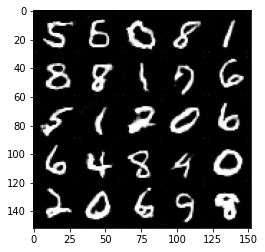

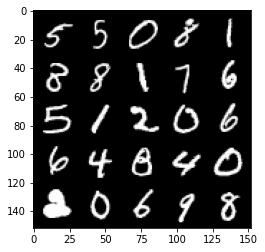

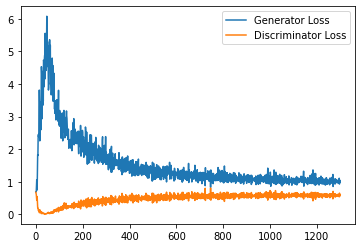

Step 26500: Generator loss: 1.0493811223506928, discriminator loss: 0.589863706946373


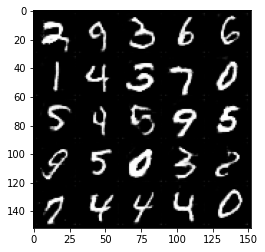

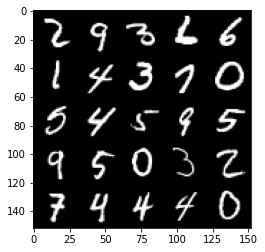

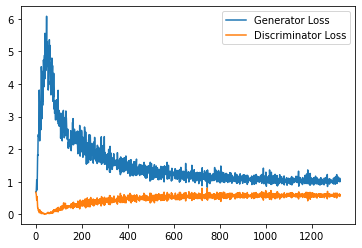

Step 27000: Generator loss: 1.0144667159318923, discriminator loss: 0.590536366045475


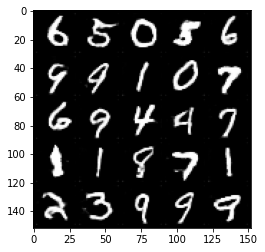

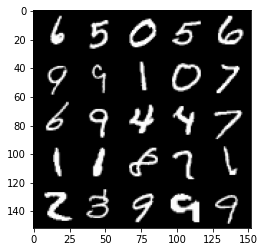

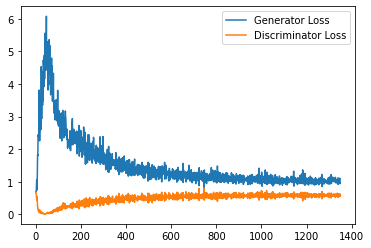

Step 27500: Generator loss: 1.0360221084356307, discriminator loss: 0.5892725130319595


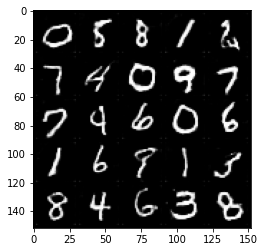

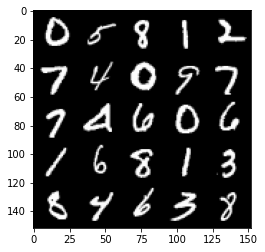

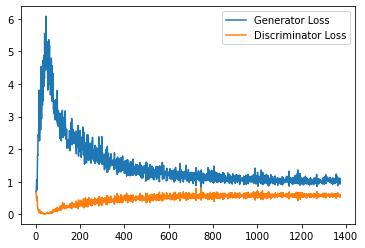

Step 28000: Generator loss: 0.9950129988193512, discriminator loss: 0.5865961053371429


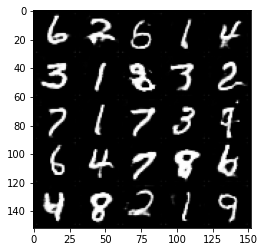

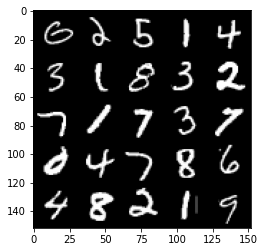

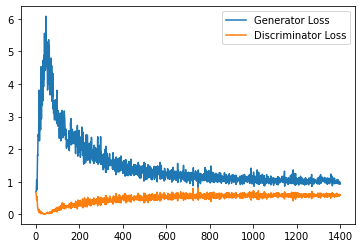

Step 28500: Generator loss: 1.0144057677984237, discriminator loss: 0.588315917313099


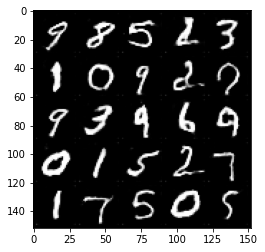

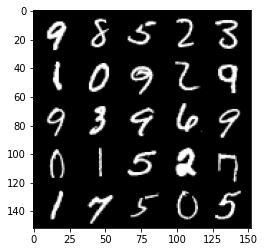

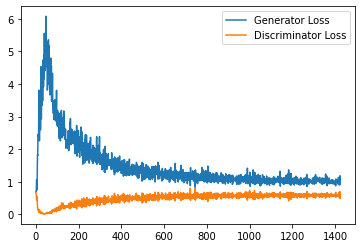

Step 29000: Generator loss: 1.008829138636589, discriminator loss: 0.5956593927741051


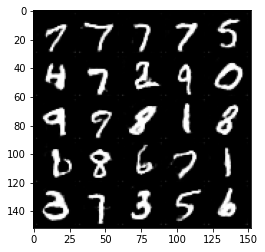

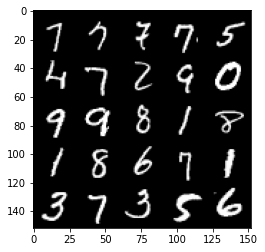

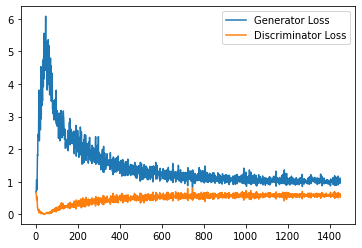

Step 29500: Generator loss: 1.0422014449834824, discriminator loss: 0.5930615594387054


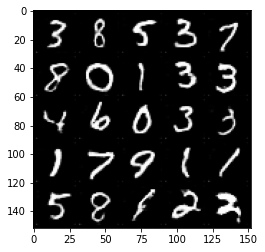

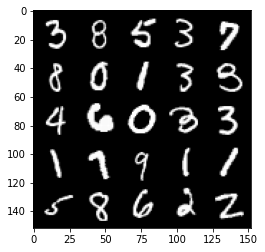

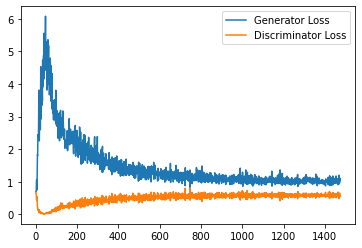

Step 30000: Generator loss: 1.008331576704979, discriminator loss: 0.6000408116579056


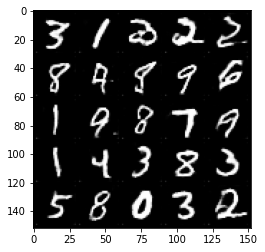

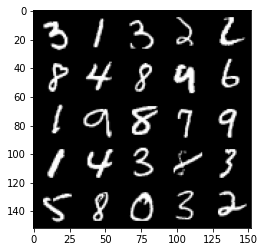

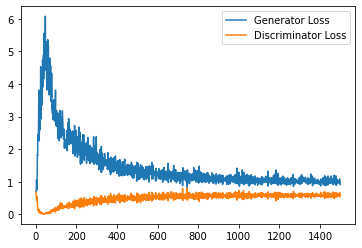

Step 30500: Generator loss: 0.9959965356588364, discriminator loss: 0.5953090259432793


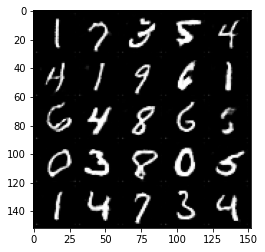

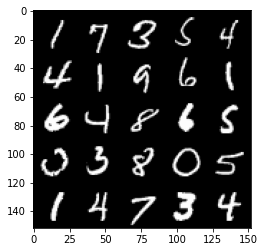

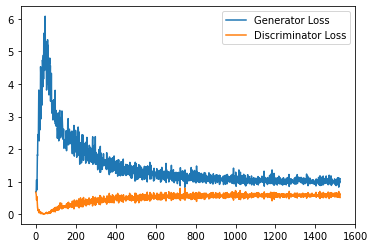

Step 31000: Generator loss: 1.0157393288612366, discriminator loss: 0.5966213265657425


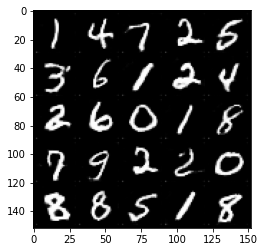

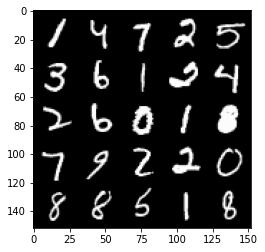

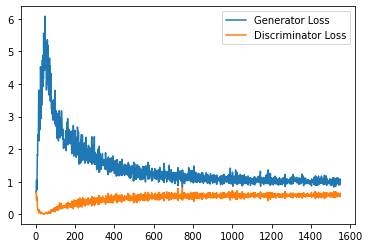

Step 31500: Generator loss: 0.9931018980741501, discriminator loss: 0.5975678577423096


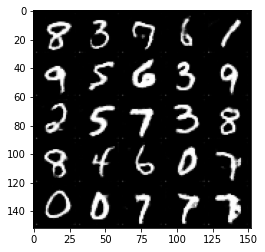

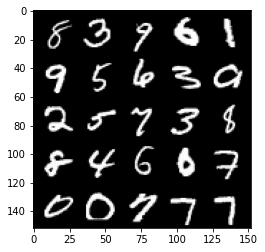

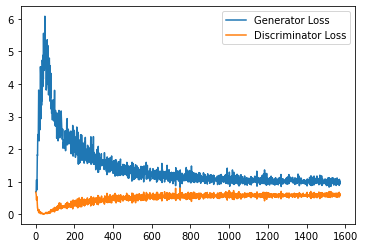

Step 32000: Generator loss: 1.025062393784523, discriminator loss: 0.5905578891634942


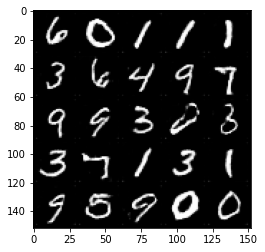

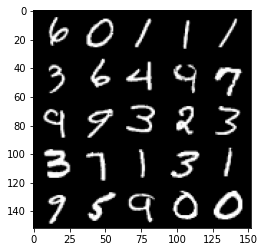

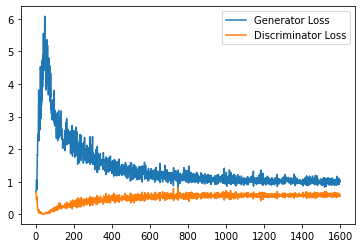

Step 32500: Generator loss: 0.9993687831163406, discriminator loss: 0.6023959844112396


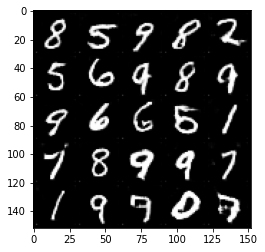

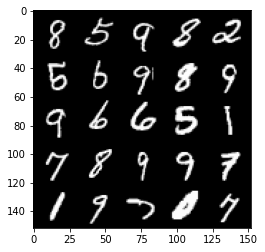

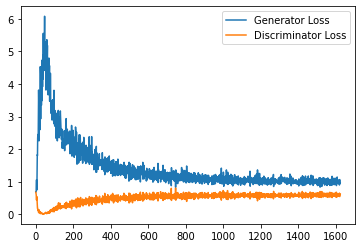

Step 33000: Generator loss: 0.9921269575357438, discriminator loss: 0.5970092694759369


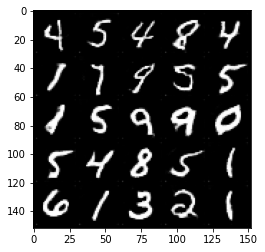

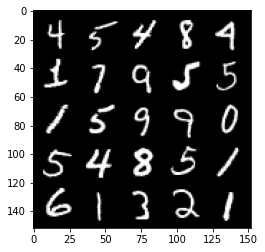

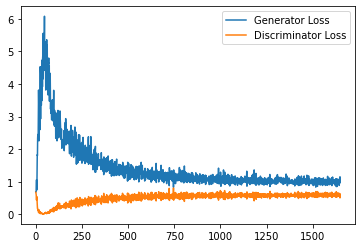

Step 33500: Generator loss: 0.9943059889078141, discriminator loss: 0.5970632642507553


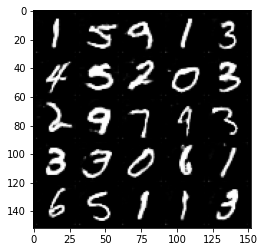

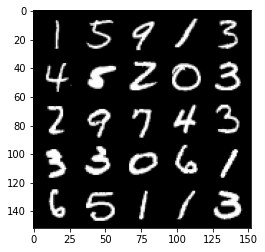

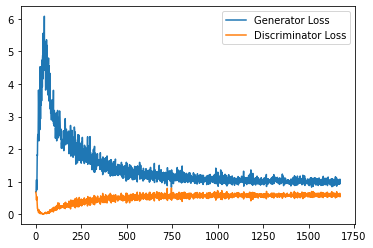

Step 34000: Generator loss: 0.9811248373985291, discriminator loss: 0.5996180015802384


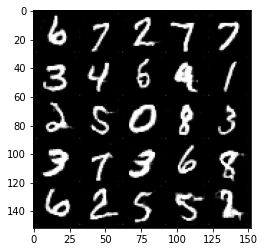

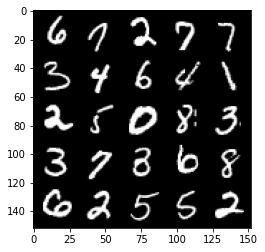

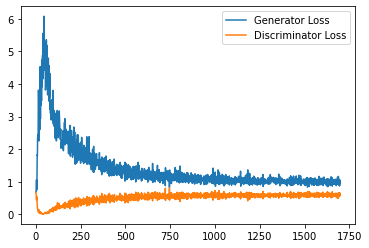

Step 34500: Generator loss: 1.0017340319156647, discriminator loss: 0.5952282794117928


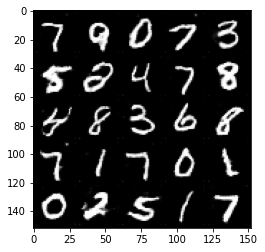

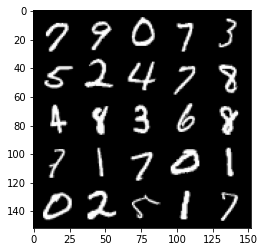

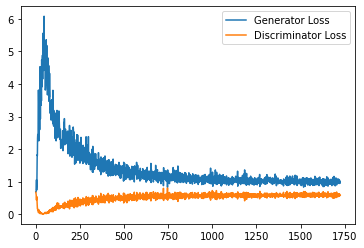

Step 35000: Generator loss: 1.0098030775785447, discriminator loss: 0.6027095244526863


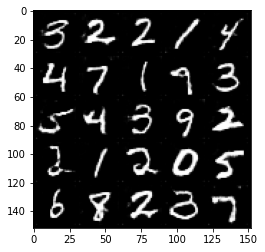

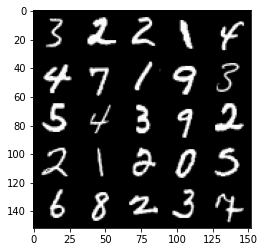

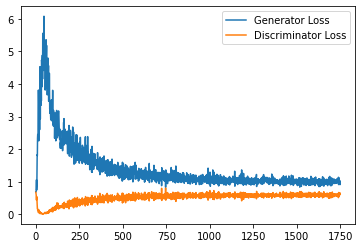

Step 35500: Generator loss: 0.9929833571910858, discriminator loss: 0.6063615148067474


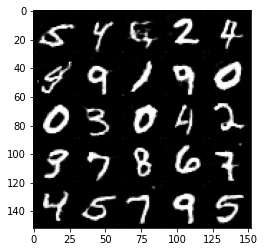

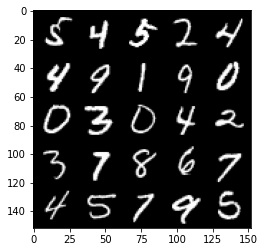

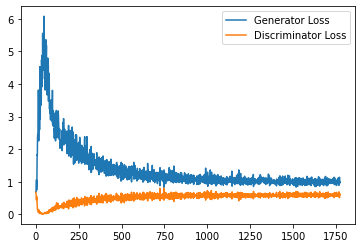

Step 36000: Generator loss: 1.008685734629631, discriminator loss: 0.5952780655026436


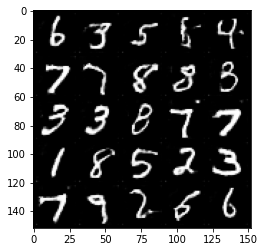

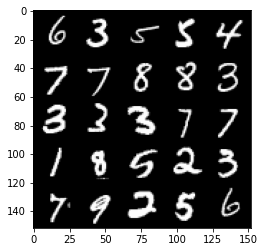

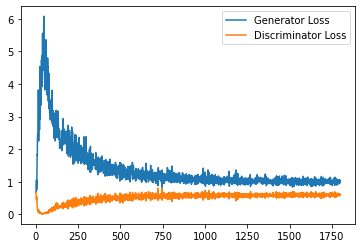

Step 36500: Generator loss: 0.9920272732973099, discriminator loss: 0.6047868978381157


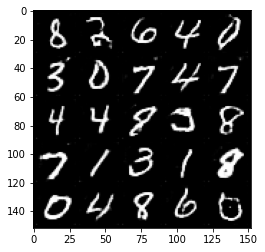

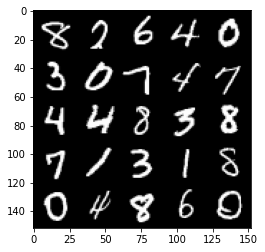

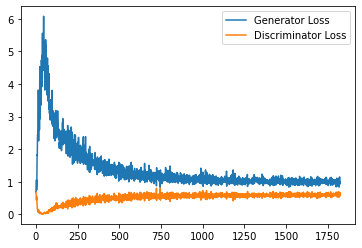

Step 37000: Generator loss: 0.9855716065168381, discriminator loss: 0.6036798932552337


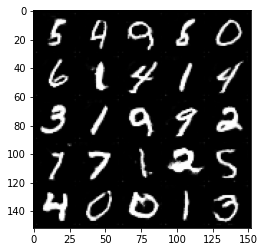

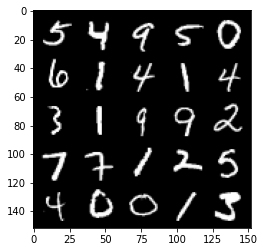

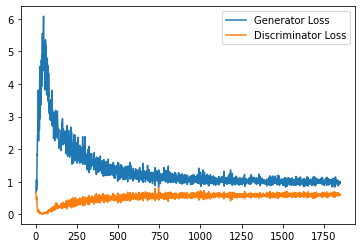

Step 37500: Generator loss: 0.9836676962375641, discriminator loss: 0.6028284409046173


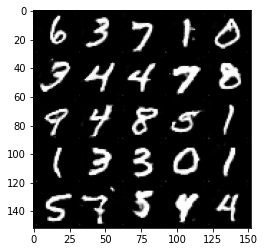

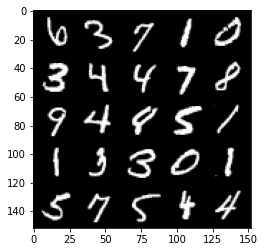

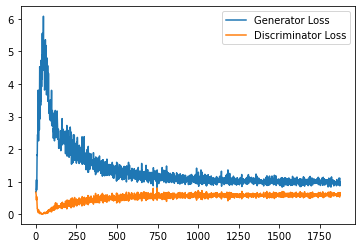

Step 38000: Generator loss: 1.0110826085805893, discriminator loss: 0.6020460070967675


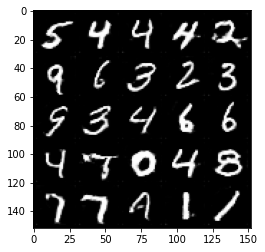

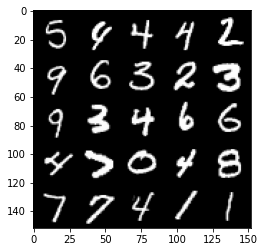

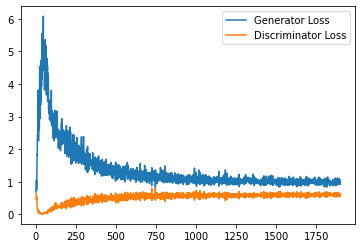

Step 38500: Generator loss: 0.979880263209343, discriminator loss: 0.600190711915493


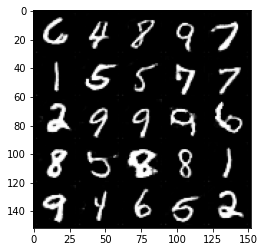

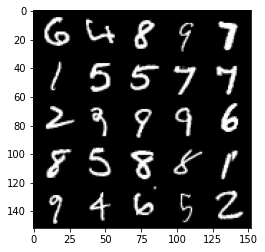

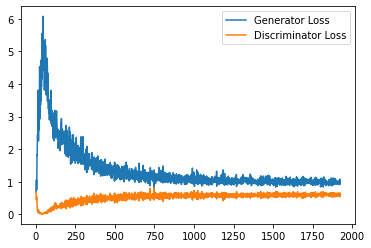

Step 39000: Generator loss: 0.994023823261261, discriminator loss: 0.6016314707994461


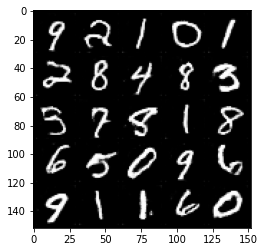

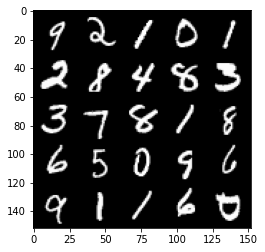

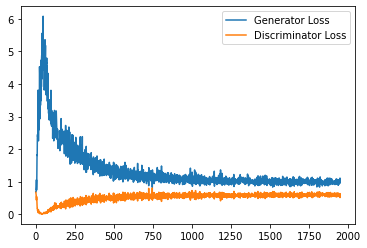

Step 39500: Generator loss: 1.0044051027297973, discriminator loss: 0.5994777550697327


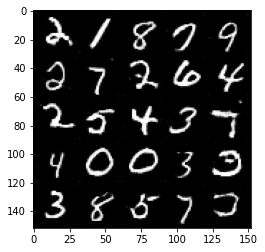

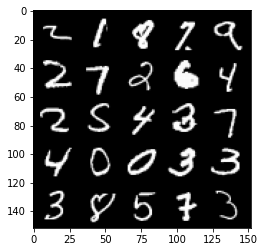

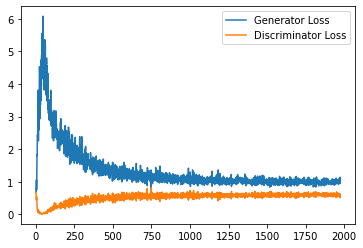

Step 40000: Generator loss: 0.9777777901887894, discriminator loss: 0.6117603840231896


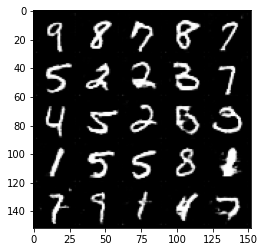

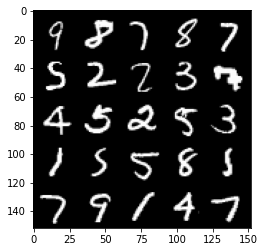

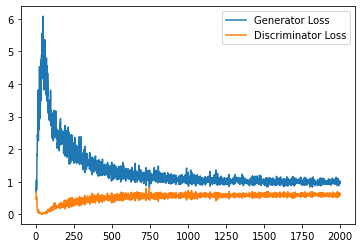

Step 40500: Generator loss: 0.9751445443630219, discriminator loss: 0.6091960546970367


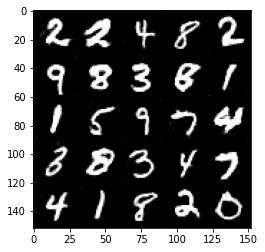

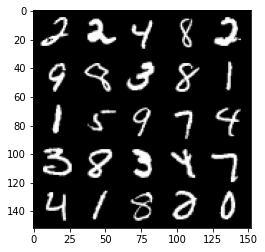

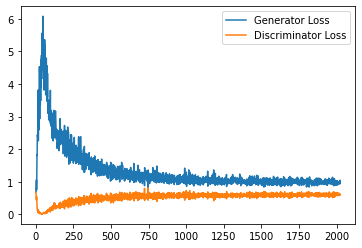

Step 41000: Generator loss: 0.9813976188898087, discriminator loss: 0.6018135317564011


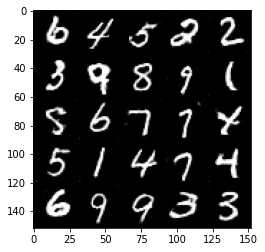

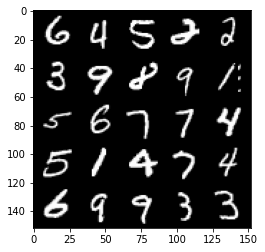

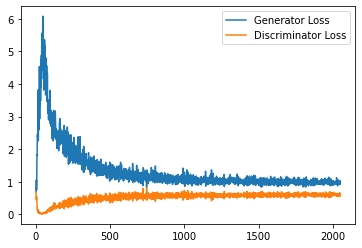

Step 41500: Generator loss: 0.9648760445117951, discriminator loss: 0.6036249253749847


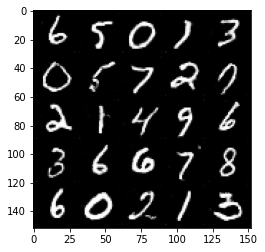

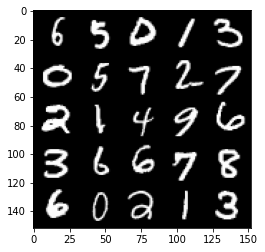

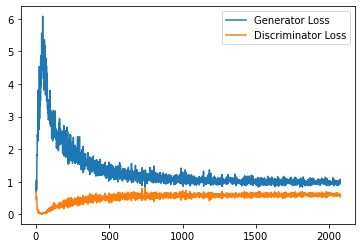

Step 42000: Generator loss: 0.9935420236587524, discriminator loss: 0.6077388255596161


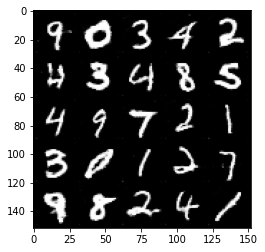

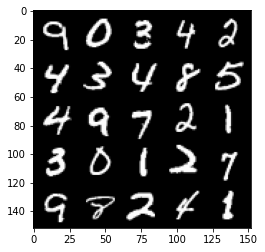

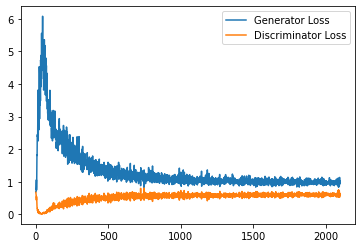

Step 42500: Generator loss: 0.9810430920124054, discriminator loss: 0.599988362789154


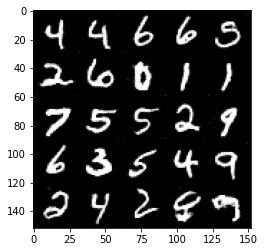

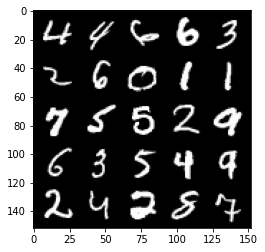

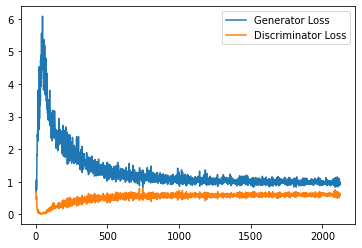

Step 43000: Generator loss: 0.9985184464454651, discriminator loss: 0.6042649261355401


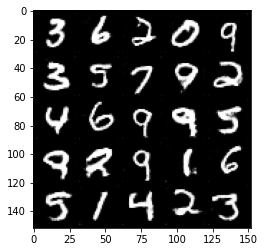

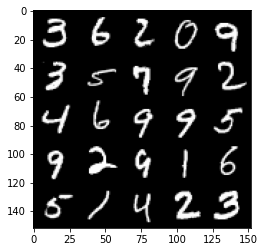

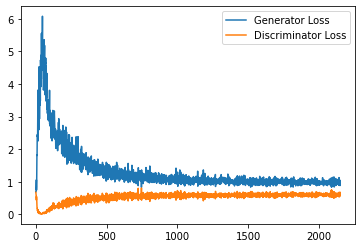

Step 43500: Generator loss: 0.9933478881120682, discriminator loss: 0.6028316994309425


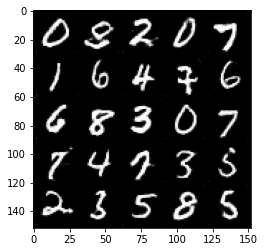

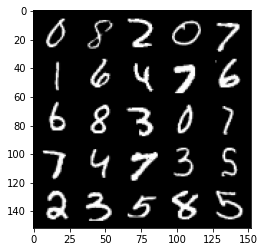

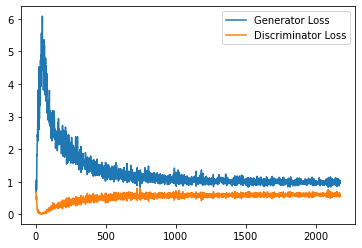

Step 44000: Generator loss: 0.976838616013527, discriminator loss: 0.6056214319467544


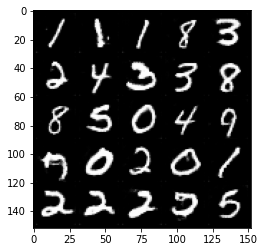

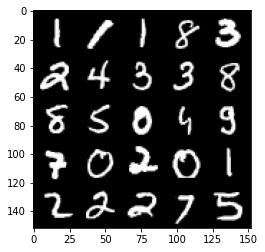

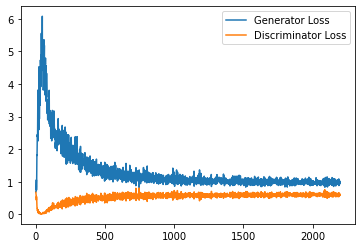

Step 44500: Generator loss: 0.9754151151180267, discriminator loss: 0.6021606224775314


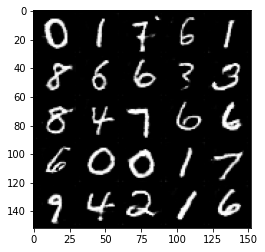

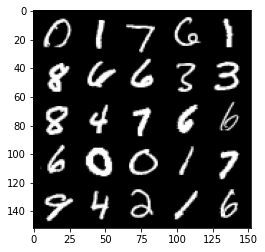

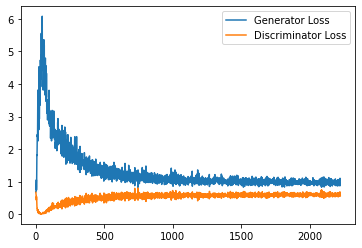

Step 45000: Generator loss: 0.9786772705316543, discriminator loss: 0.5968018419146538


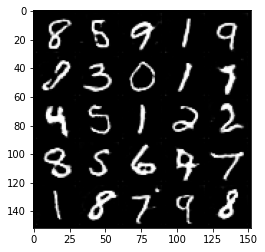

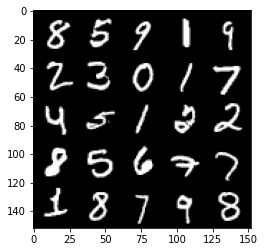

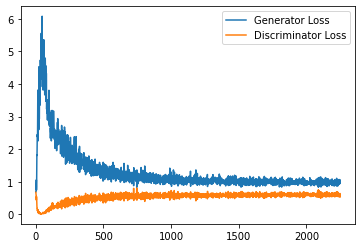

Step 45500: Generator loss: 0.9856924388408661, discriminator loss: 0.6071670960783958


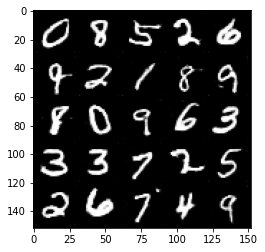

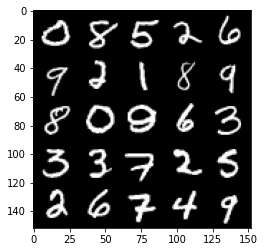

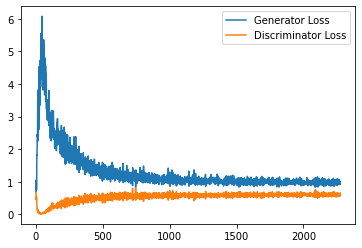

Step 46000: Generator loss: 0.979158298254013, discriminator loss: 0.5967252891659737


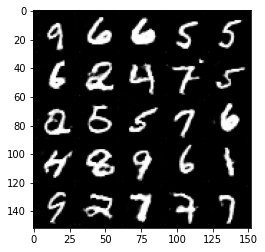

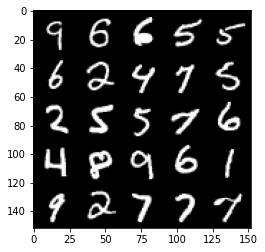

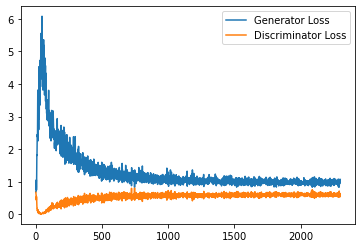

Step 46500: Generator loss: 0.9864983899593354, discriminator loss: 0.6076138295531273


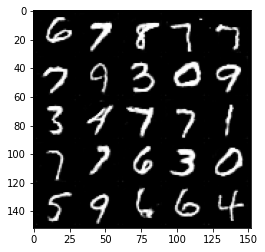

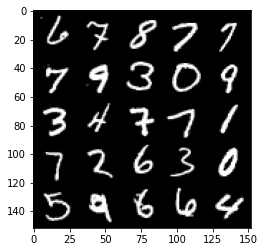

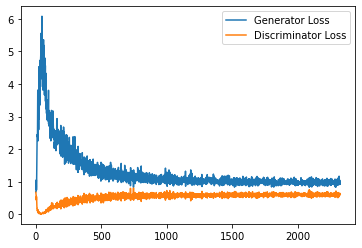

Step 47000: Generator loss: 0.9949280687570572, discriminator loss: 0.5995681059360504


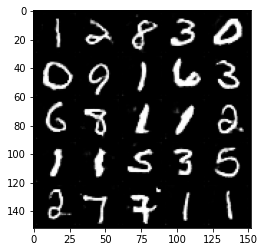

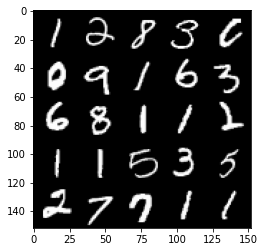

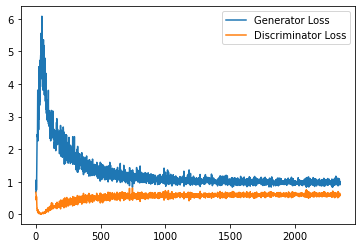

Step 47500: Generator loss: 0.9982406591176987, discriminator loss: 0.5995535312891006


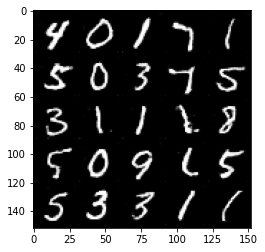

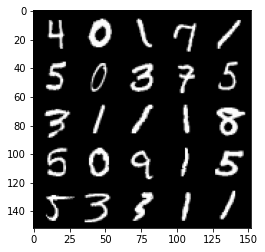

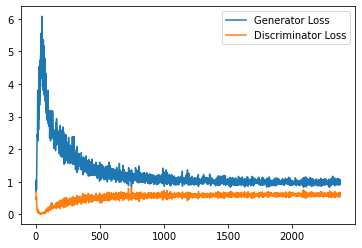

Step 48000: Generator loss: 0.9736476150751114, discriminator loss: 0.6022858679890633


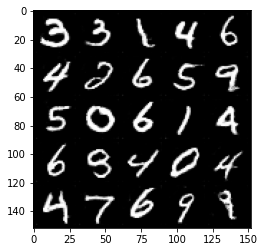

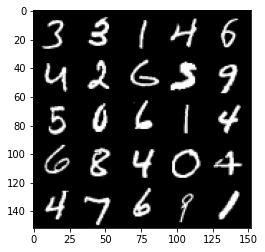

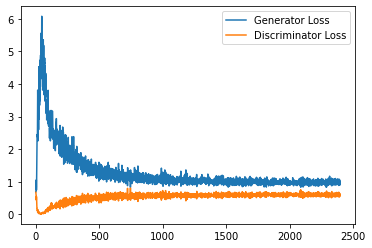

Step 48500: Generator loss: 0.9689909621477127, discriminator loss: 0.6000435240864753


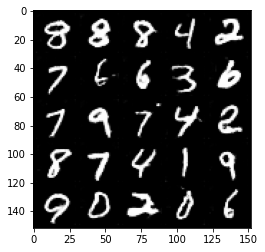

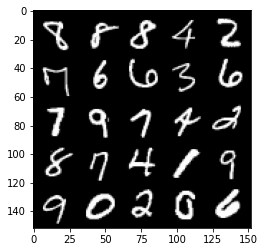

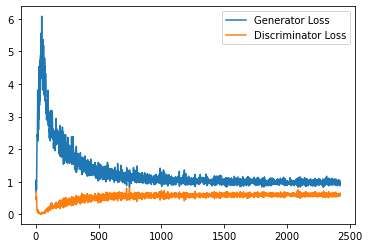

Step 49000: Generator loss: 1.0057072356939316, discriminator loss: 0.593846244931221


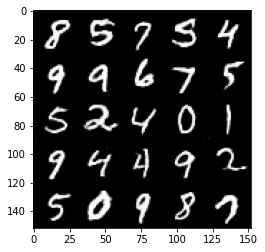

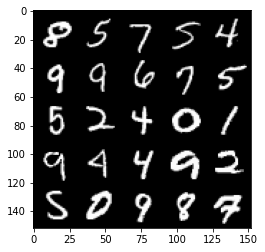

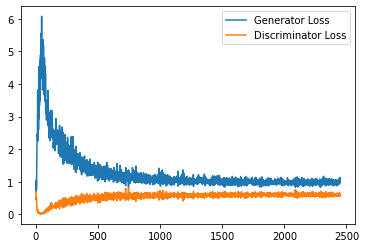

Step 49500: Generator loss: 1.0046947271823883, discriminator loss: 0.5973055053949357


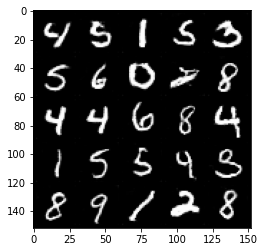

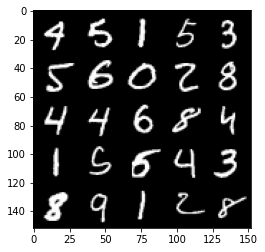

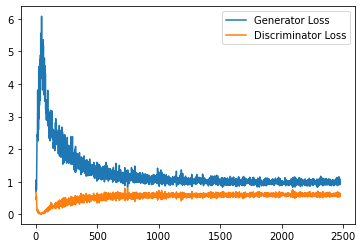

Step 50000: Generator loss: 0.9850071116685867, discriminator loss: 0.6043359842300415


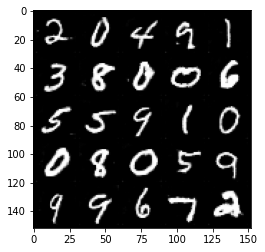

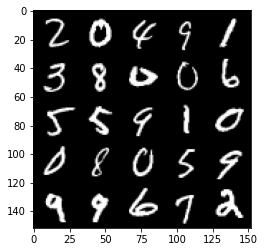

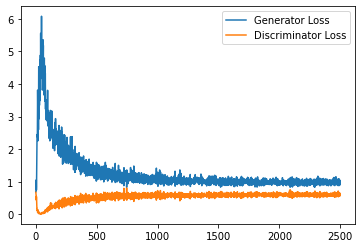

Step 50500: Generator loss: 0.9822719326019287, discriminator loss: 0.5987437553405762


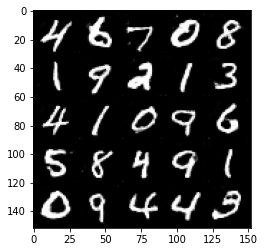

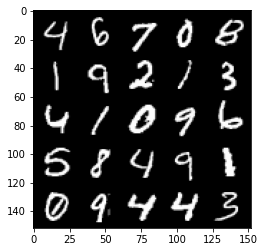

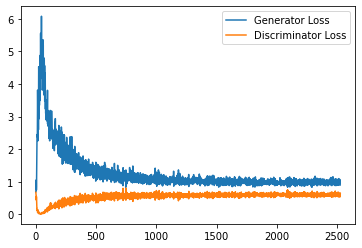

Step 51000: Generator loss: 0.997724155664444, discriminator loss: 0.5994502422213555


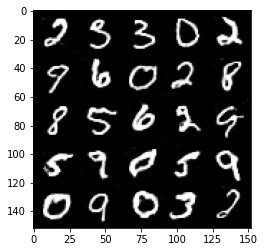

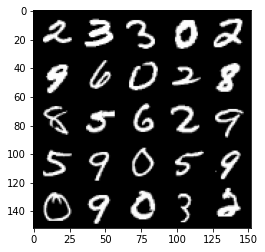

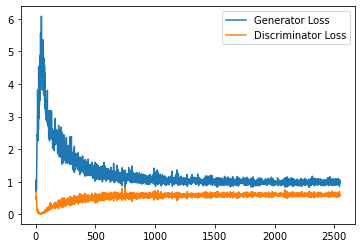

Step 51500: Generator loss: 0.9977225536108016, discriminator loss: 0.5923907896280288


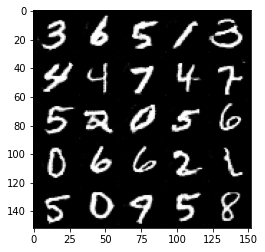

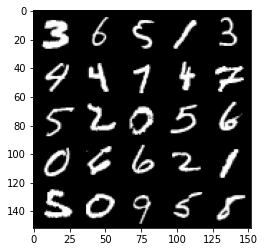

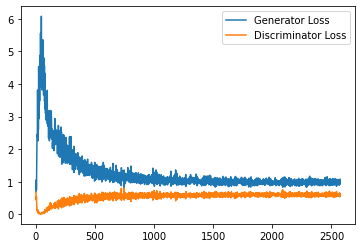

Step 52000: Generator loss: 1.0051380715370177, discriminator loss: 0.589190669298172


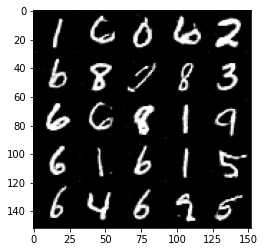

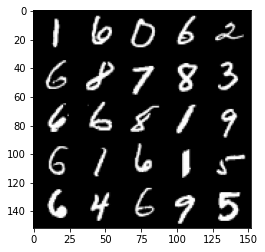

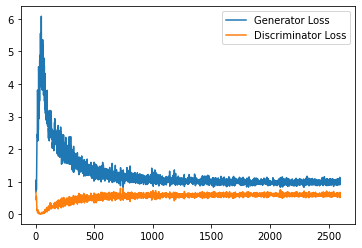

Step 52500: Generator loss: 1.0061172293424607, discriminator loss: 0.5898568427562714


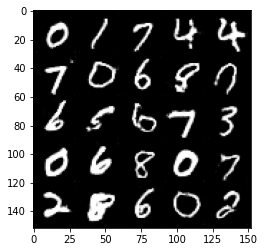

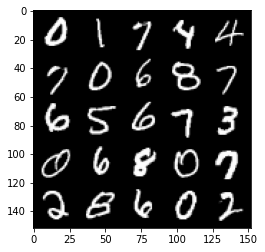

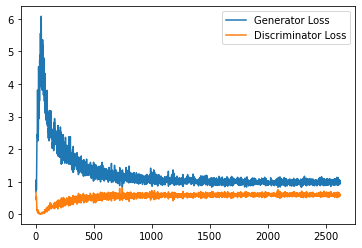

Step 53000: Generator loss: 1.0005951875448227, discriminator loss: 0.591028870344162


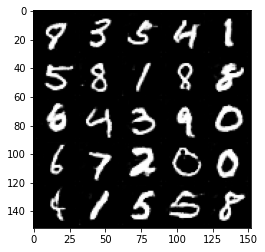

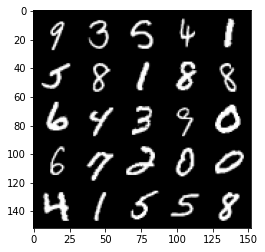

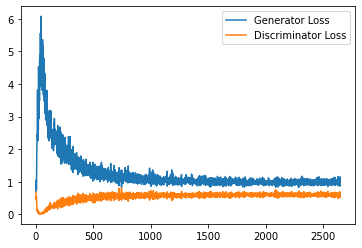

Step 53500: Generator loss: 1.006109566450119, discriminator loss: 0.5888917828202248


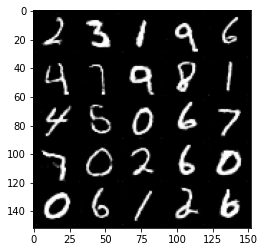

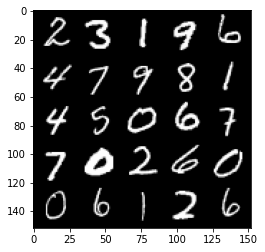

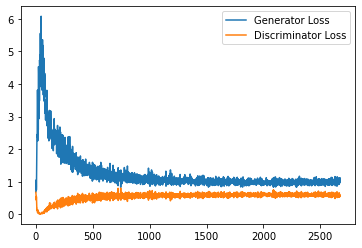

Step 54000: Generator loss: 1.0007358911037445, discriminator loss: 0.5947733598351479


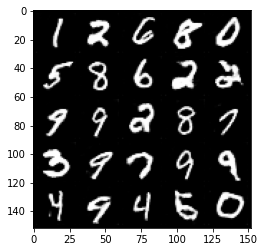

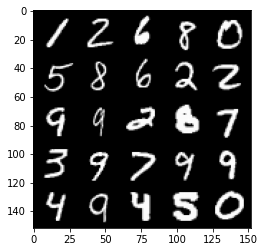

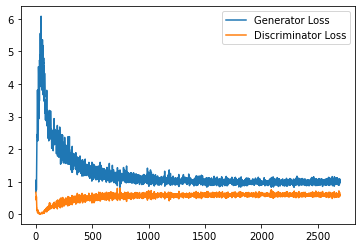

Step 54500: Generator loss: 1.0082356427907944, discriminator loss: 0.5867392963171005


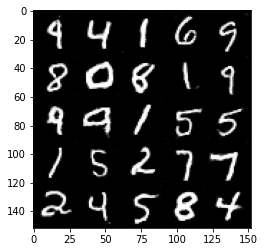

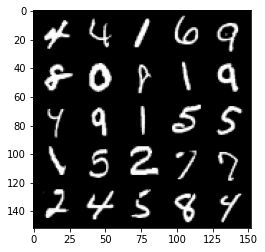

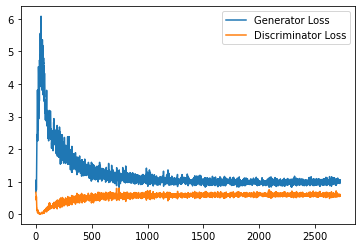

Step 55000: Generator loss: 1.0162647330760957, discriminator loss: 0.5865429393053054


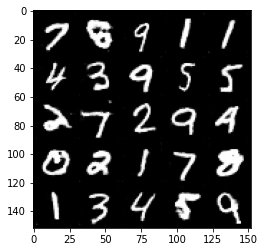

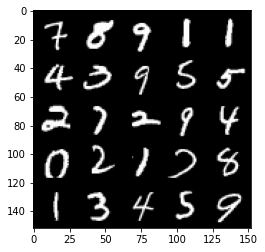

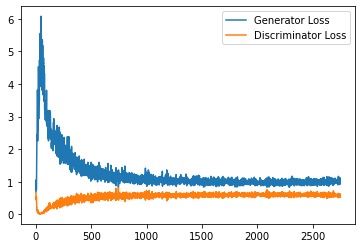

Step 55500: Generator loss: 1.024902302980423, discriminator loss: 0.5825723232030868


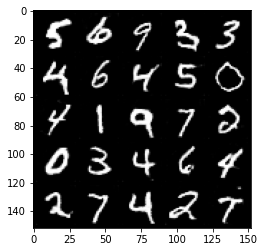

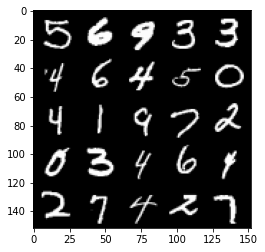

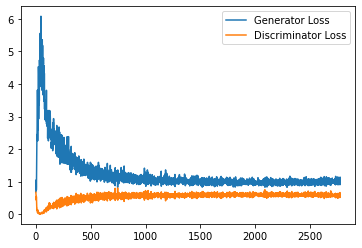

Step 56000: Generator loss: 1.0226423590183258, discriminator loss: 0.583450127363205


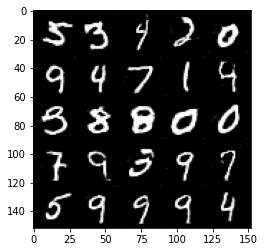

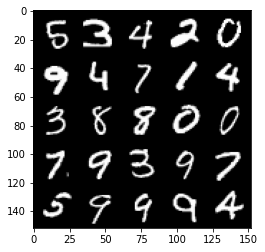

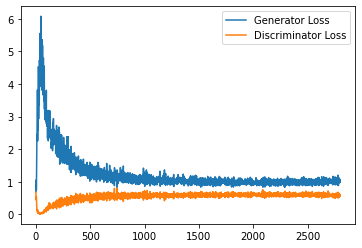

Step 56500: Generator loss: 1.028091423034668, discriminator loss: 0.5805897273421288


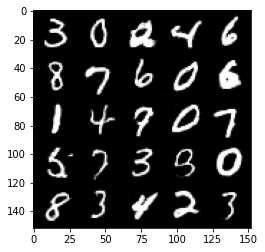

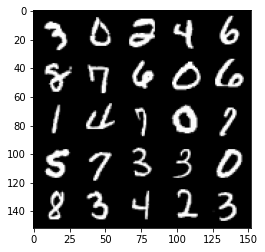

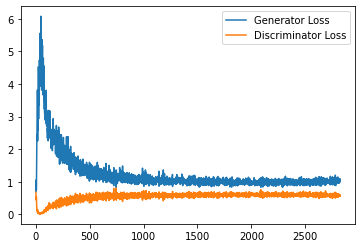

Step 57000: Generator loss: 1.0459053902626037, discriminator loss: 0.5850026369094848


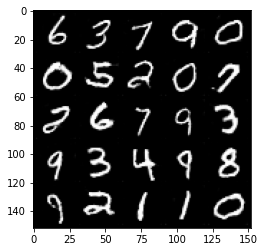

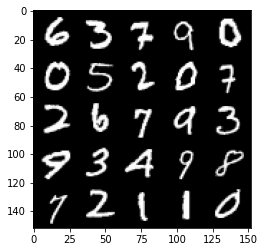

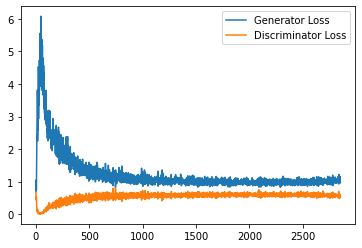

Step 57500: Generator loss: 1.0077337028980256, discriminator loss: 0.5811767498850823


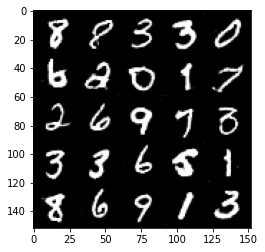

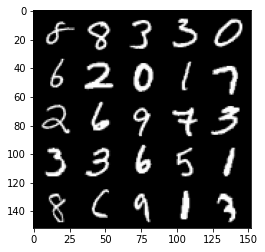

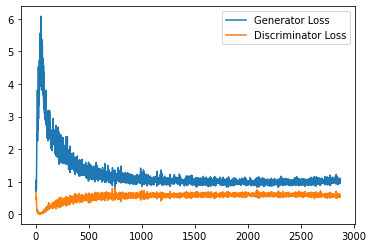

Step 58000: Generator loss: 1.0414809173345565, discriminator loss: 0.5778047535419464


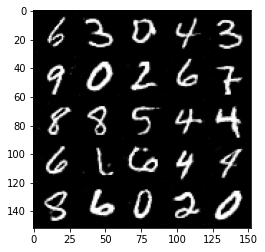

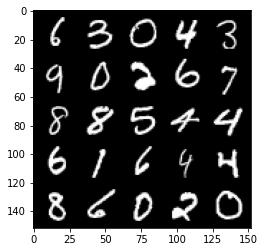

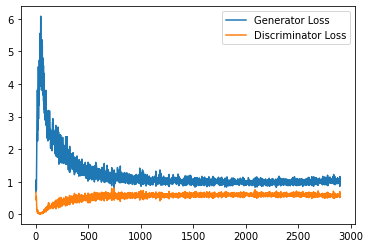

Step 58500: Generator loss: 1.0335695744752884, discriminator loss: 0.580075954914093


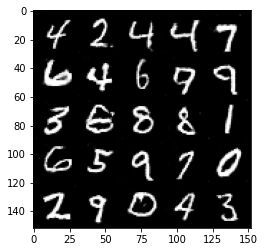

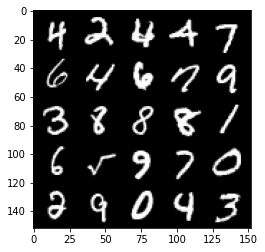

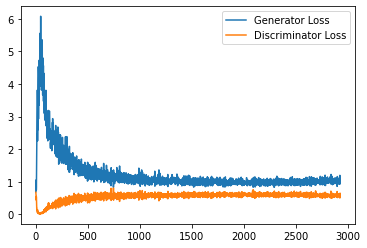

Step 59000: Generator loss: 1.03314679479599, discriminator loss: 0.5745647982358932


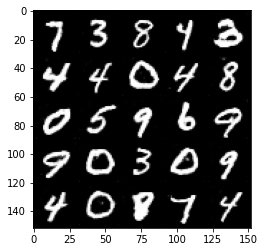

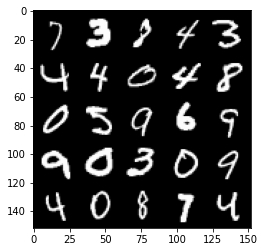

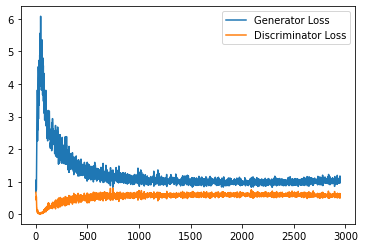

Step 59500: Generator loss: 1.0347724145650863, discriminator loss: 0.5799717084765434


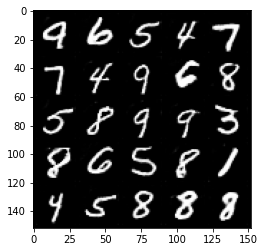

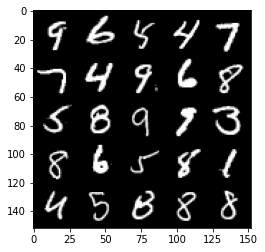

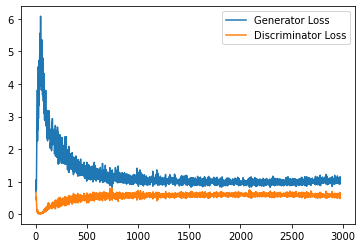

Step 60000: Generator loss: 1.0129027383327485, discriminator loss: 0.5803054015040398


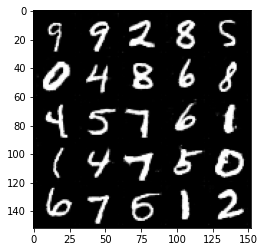

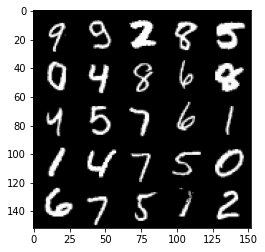

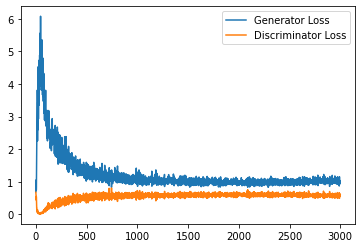

Step 60500: Generator loss: 1.0425869724750518, discriminator loss: 0.5734134221076965


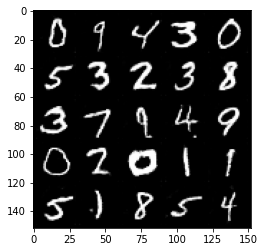

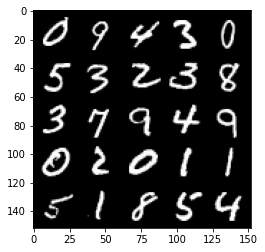

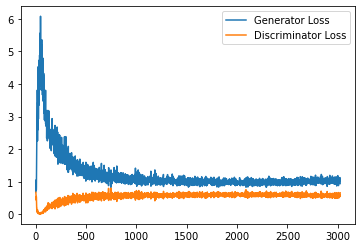

Step 61000: Generator loss: 1.0549414253234863, discriminator loss: 0.5704073763489723


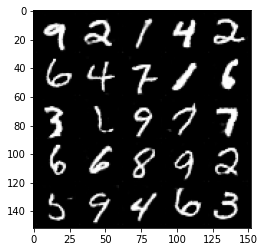

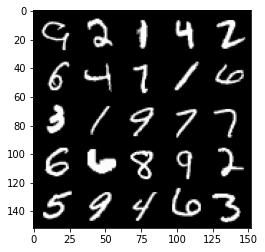

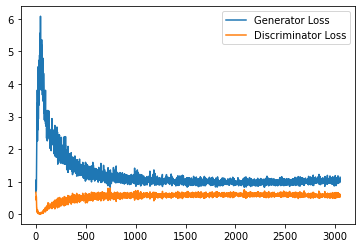

Step 61500: Generator loss: 1.0624892206192016, discriminator loss: 0.57680551725626


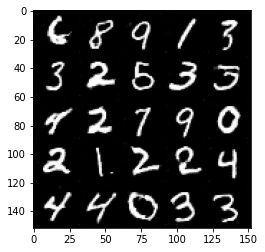

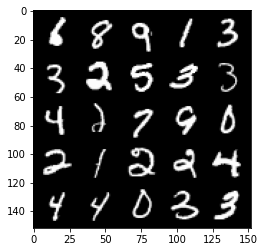

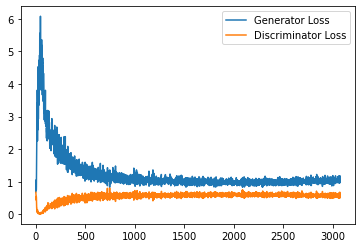

Step 62000: Generator loss: 1.0466209008693694, discriminator loss: 0.5746027953624725


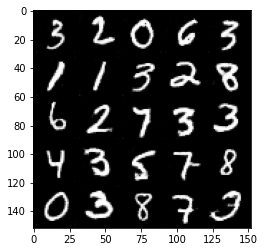

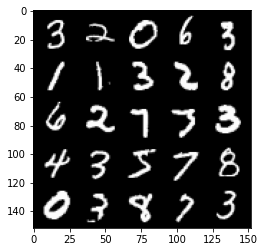

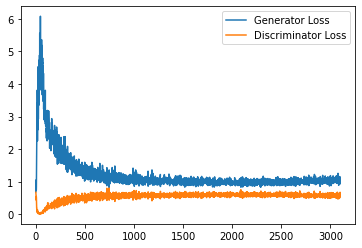

Step 62500: Generator loss: 1.040656947016716, discriminator loss: 0.5683884764909745


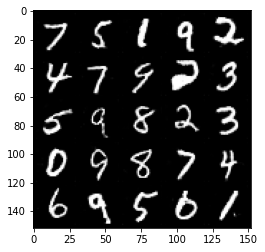

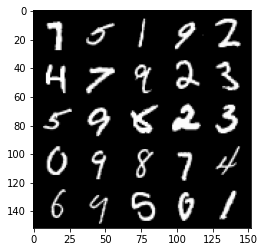

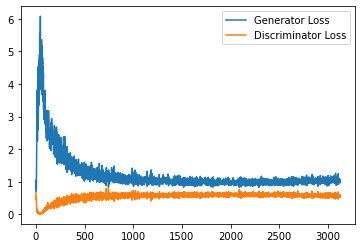

Step 63000: Generator loss: 1.045496167778969, discriminator loss: 0.5668776404857635


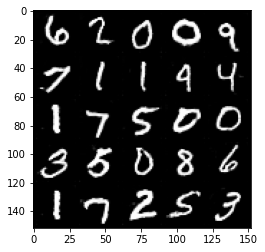

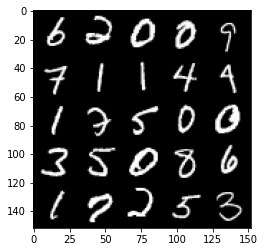

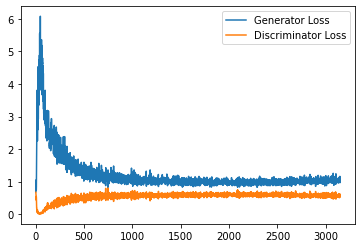

Step 63500: Generator loss: 1.0477241089344025, discriminator loss: 0.5702066410183907


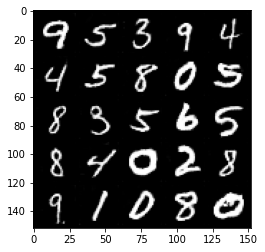

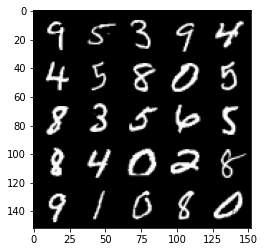

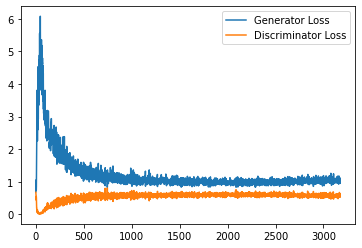

Step 64000: Generator loss: 1.0669080102443695, discriminator loss: 0.5682604848146439


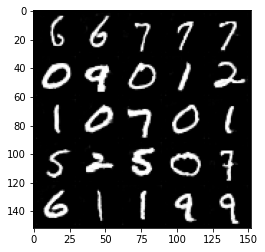

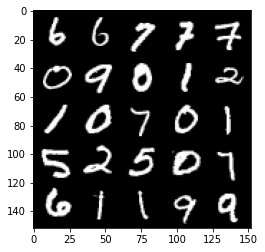

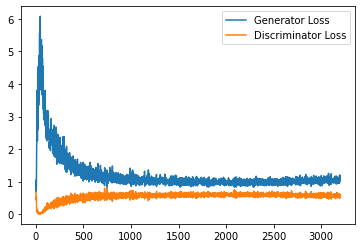

Step 64500: Generator loss: 1.0691010718345642, discriminator loss: 0.5728304876685143


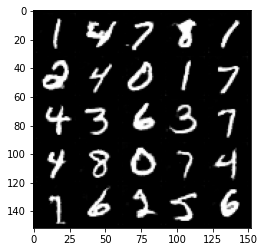

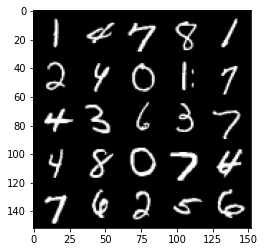

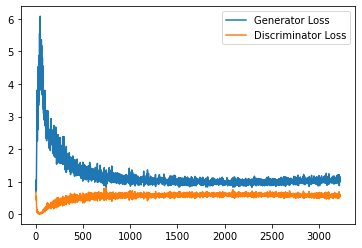

Step 65000: Generator loss: 1.0652470757961274, discriminator loss: 0.5676743784546852


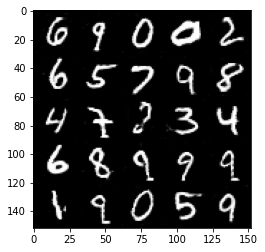

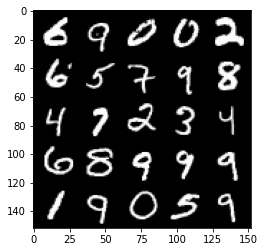

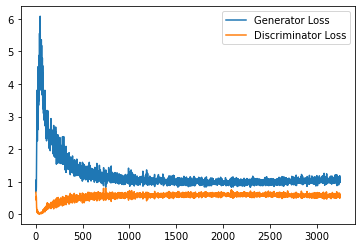

Step 65500: Generator loss: 1.0648830407857894, discriminator loss: 0.5664364159107208


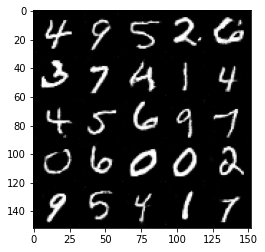

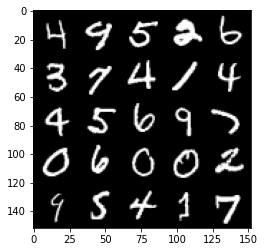

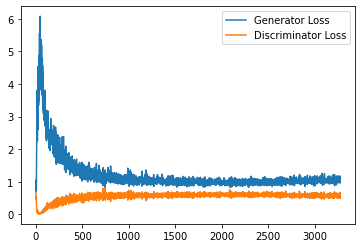

Step 66000: Generator loss: 1.0617925015687943, discriminator loss: 0.5675989143848419


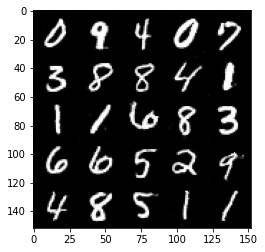

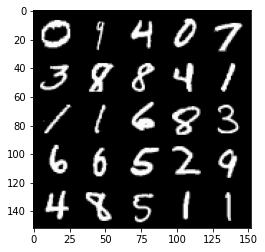

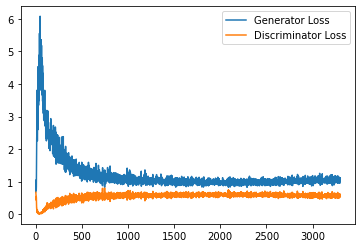

Step 66500: Generator loss: 1.0606647773981095, discriminator loss: 0.5650268433690071


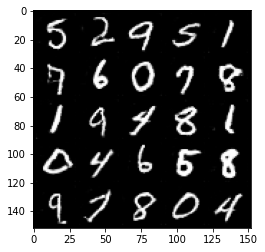

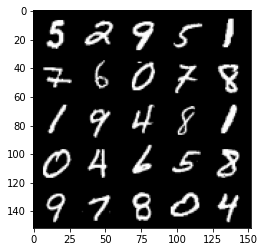

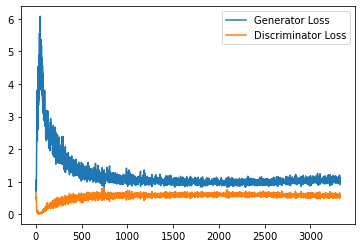

Step 67000: Generator loss: 1.08038935983181, discriminator loss: 0.5646691390872002


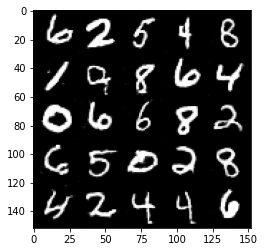

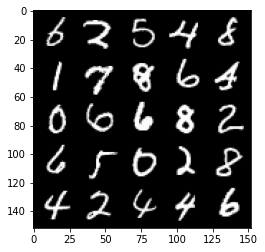

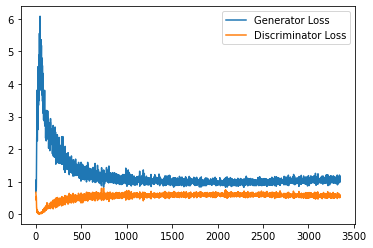

Step 67500: Generator loss: 1.0613876099586488, discriminator loss: 0.5630726444721222


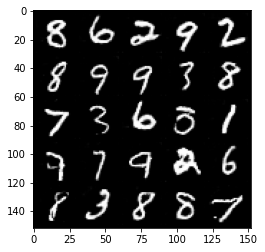

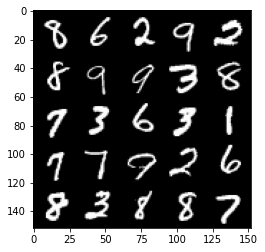

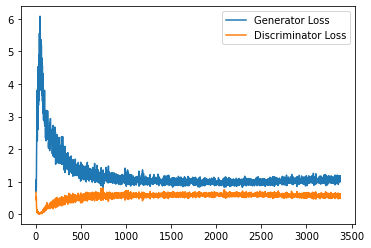

Step 68000: Generator loss: 1.0843177559375763, discriminator loss: 0.5627114346623421


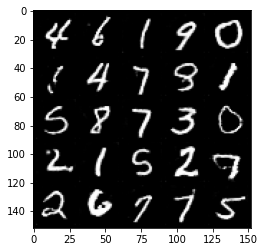

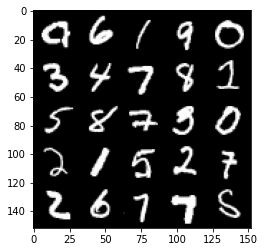

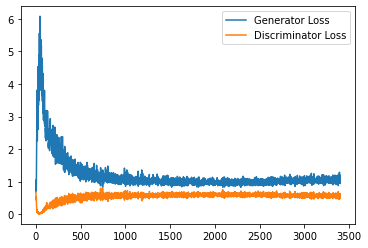

Step 68500: Generator loss: 1.0736756087541581, discriminator loss: 0.5636918375492096


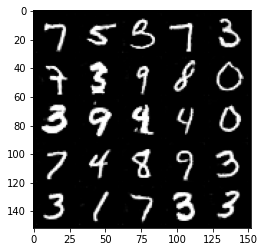

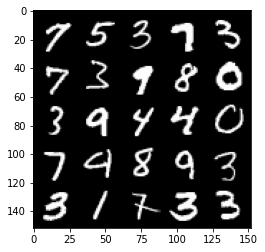

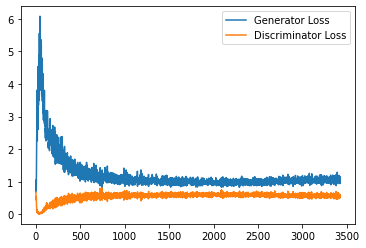

Step 69000: Generator loss: 1.0762433432340621, discriminator loss: 0.5590771515369415


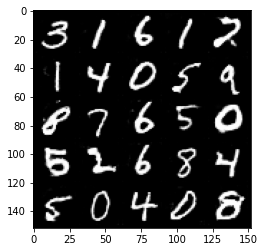

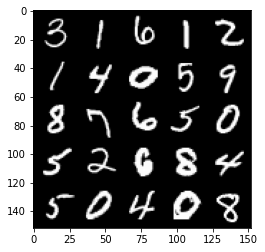

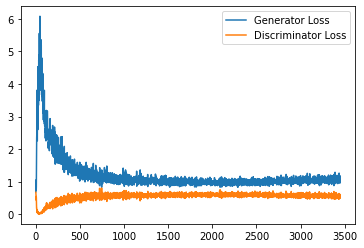

Step 69500: Generator loss: 1.1100076965093613, discriminator loss: 0.553672416806221


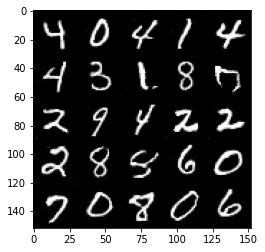

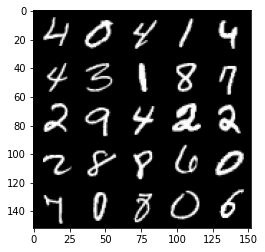

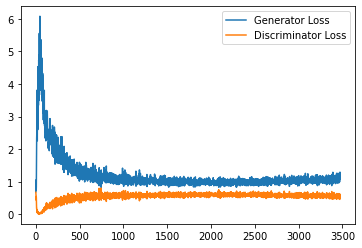

Step 70000: Generator loss: 1.0737833136320114, discriminator loss: 0.56150905585289


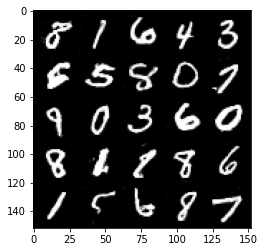

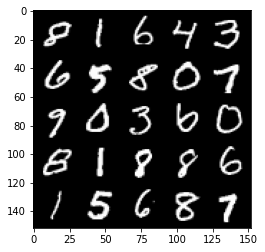

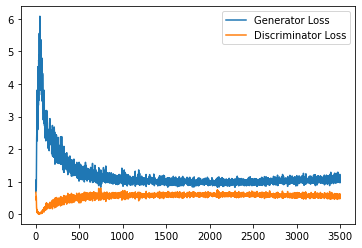

Step 70500: Generator loss: 1.080813673734665, discriminator loss: 0.554657396197319


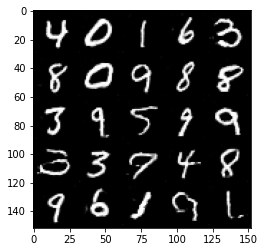

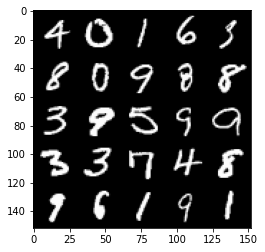

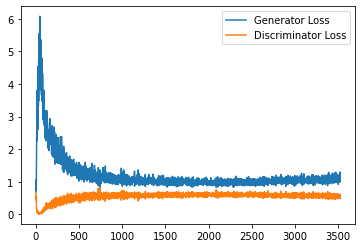

Step 71000: Generator loss: 1.092173599600792, discriminator loss: 0.5581739173531532


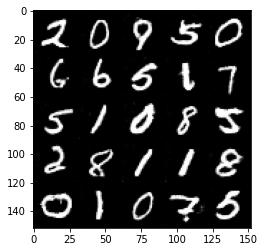

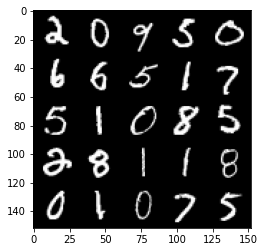

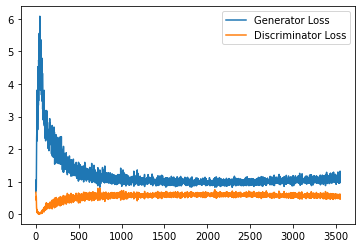

Step 71500: Generator loss: 1.1005099103450775, discriminator loss: 0.5550364986658096


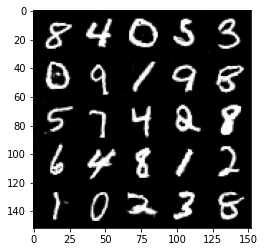

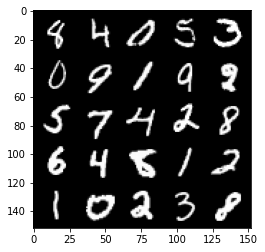

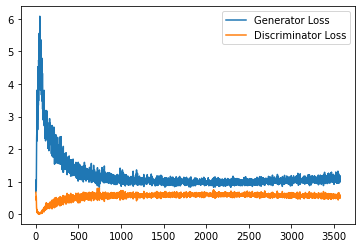

Step 72000: Generator loss: 1.1062145185470582, discriminator loss: 0.5595306448340416


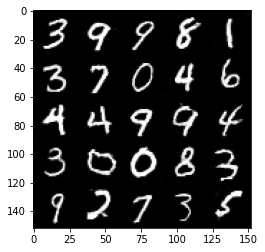

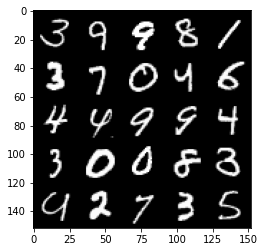

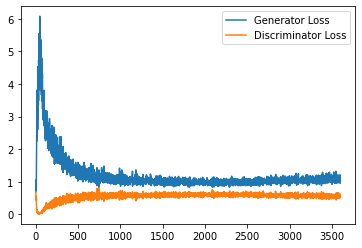

Step 72500: Generator loss: 1.0918618129491806, discriminator loss: 0.5603007472157479


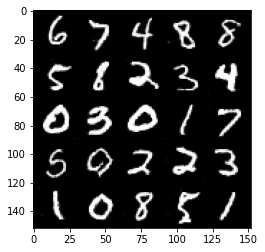

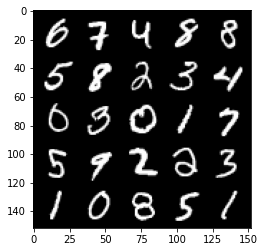

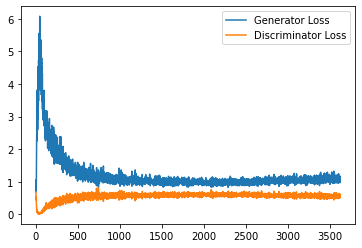

Step 73000: Generator loss: 1.0968147164583206, discriminator loss: 0.5499804340600968


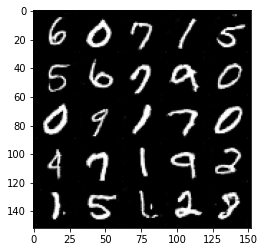

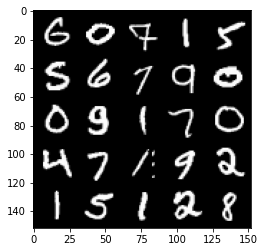

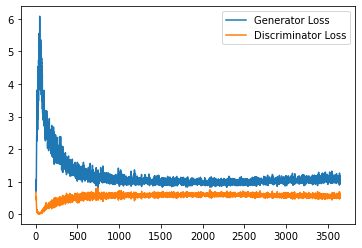

Step 73500: Generator loss: 1.102520265698433, discriminator loss: 0.5508679177165031


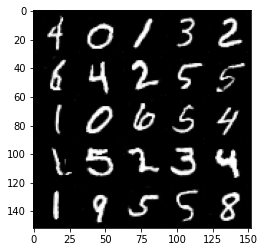

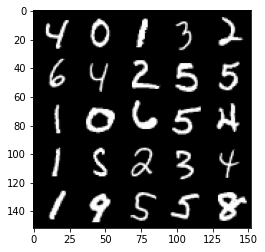

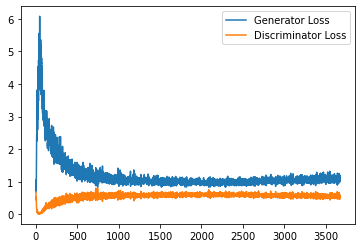

Step 74000: Generator loss: 1.0959868710041045, discriminator loss: 0.5537340127229691


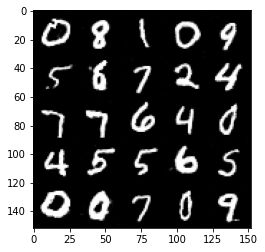

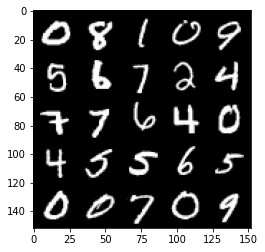

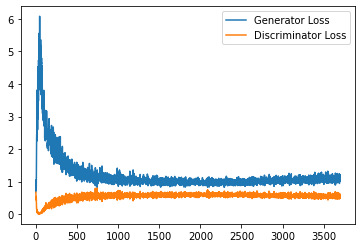

Step 74500: Generator loss: 1.0935721876621247, discriminator loss: 0.5521235497593879


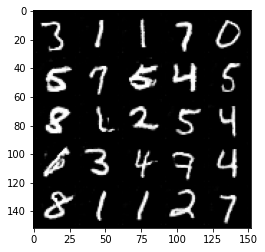

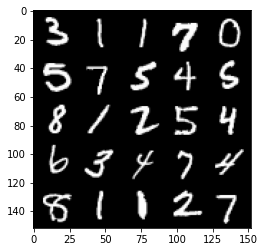

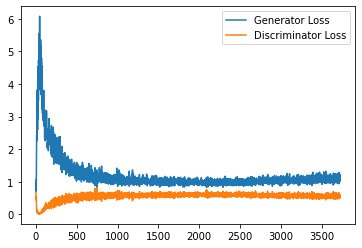

Step 75000: Generator loss: 1.1114496729373933, discriminator loss: 0.5470959823727608


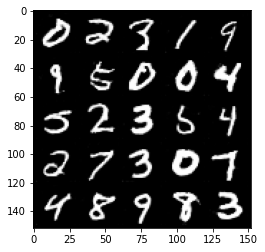

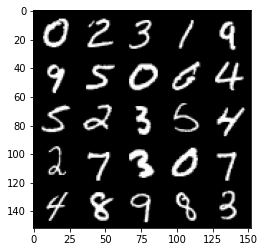

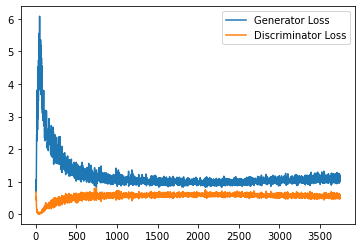

Step 75500: Generator loss: 1.1078367146253585, discriminator loss: 0.5541280038356781


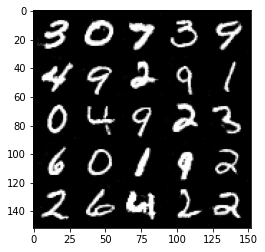

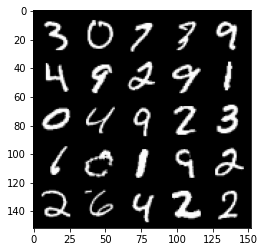

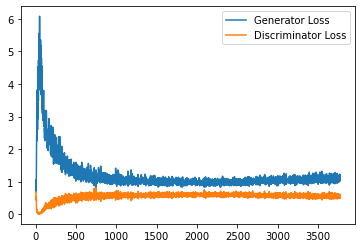

Step 76000: Generator loss: 1.1281243534088135, discriminator loss: 0.5469509019255638


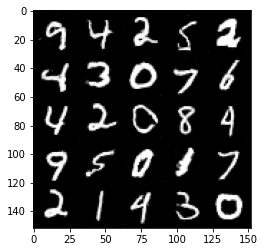

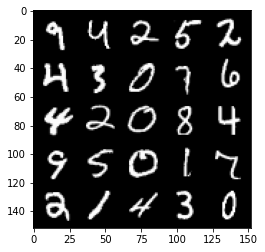

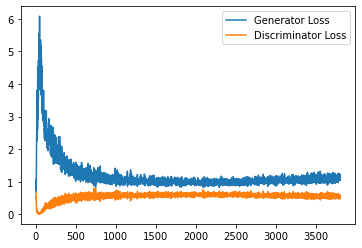

Step 76500: Generator loss: 1.1253054589033127, discriminator loss: 0.5515346997976303


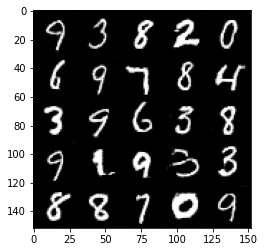

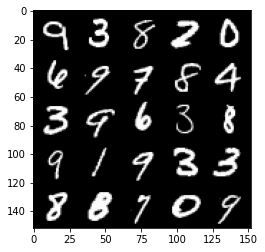

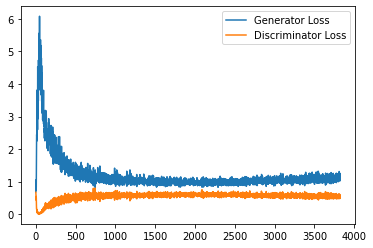

Step 77000: Generator loss: 1.1301775308847428, discriminator loss: 0.5442902377843857


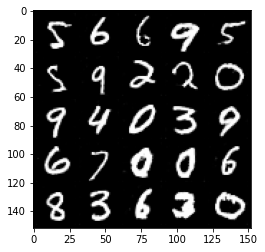

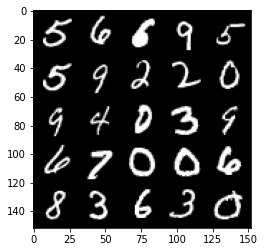

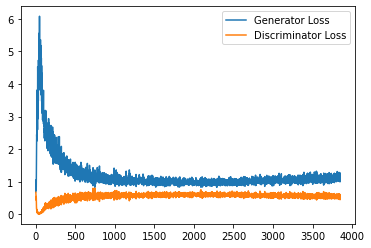

Step 77500: Generator loss: 1.1085543380975724, discriminator loss: 0.547478762626648


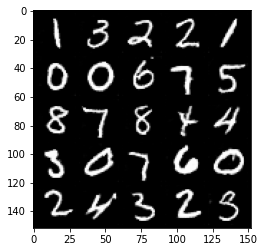

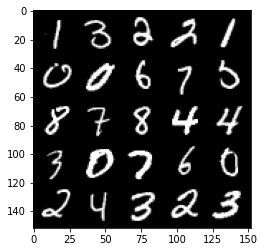

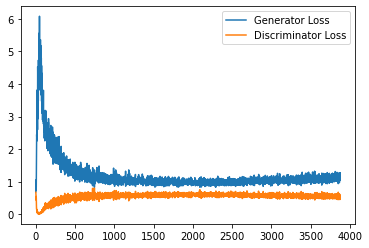

Step 78000: Generator loss: 1.1252986260652542, discriminator loss: 0.5482607954144478


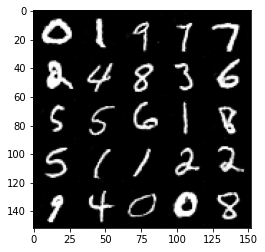

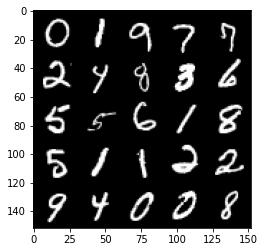

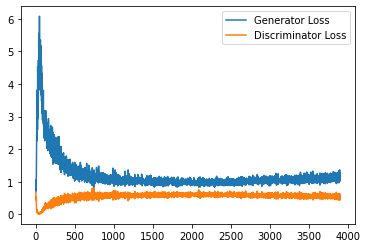

Step 78500: Generator loss: 1.115390822172165, discriminator loss: 0.5523425552845002


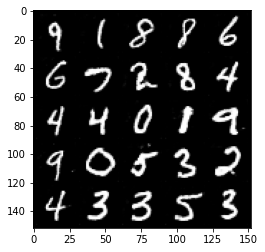

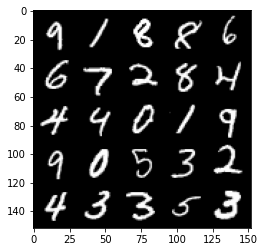

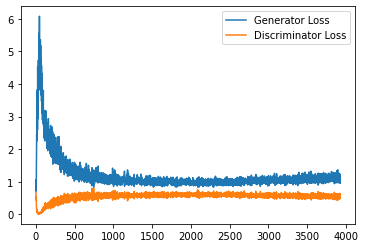

Step 79000: Generator loss: 1.108325347661972, discriminator loss: 0.5524493815898895


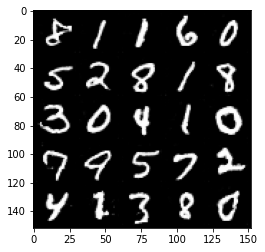

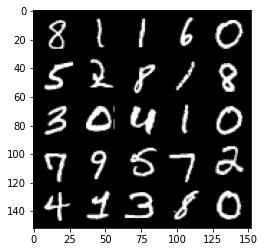

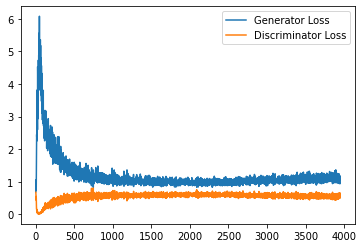

Step 79500: Generator loss: 1.119168788433075, discriminator loss: 0.5470135908126831


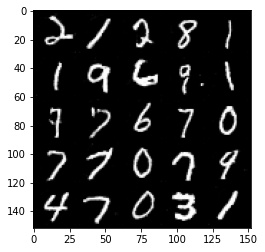

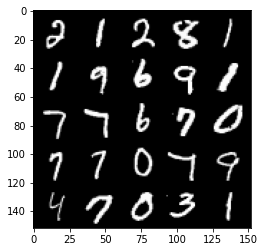

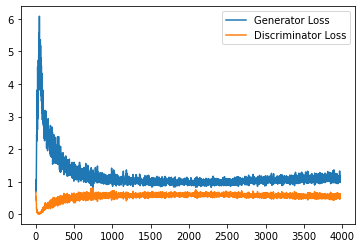

Step 80000: Generator loss: 1.117231286048889, discriminator loss: 0.5470410318374633


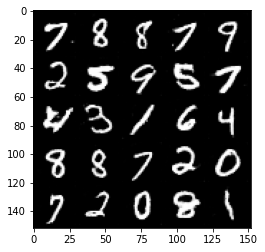

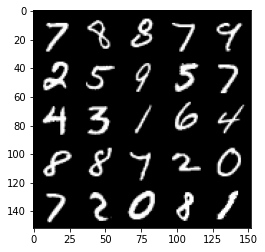

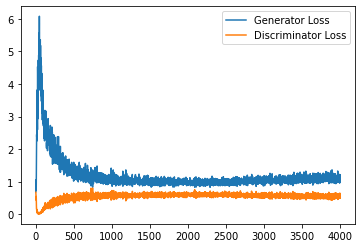

Step 80500: Generator loss: 1.1259701801538466, discriminator loss: 0.5458493702411652


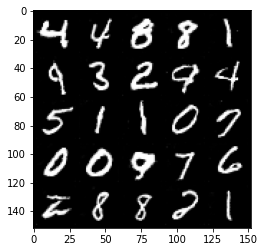

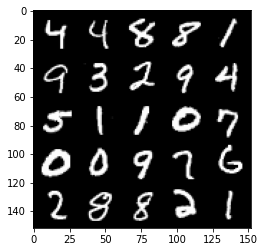

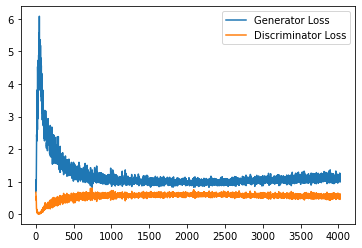

Step 81000: Generator loss: 1.1286936583518983, discriminator loss: 0.5478562840223312


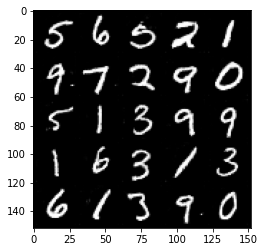

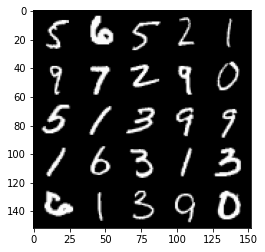

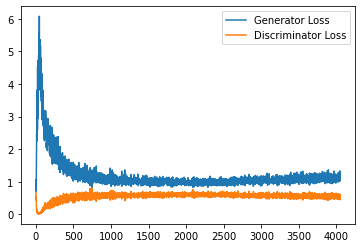

Step 81500: Generator loss: 1.1356954362392426, discriminator loss: 0.548705352127552


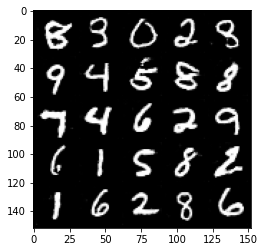

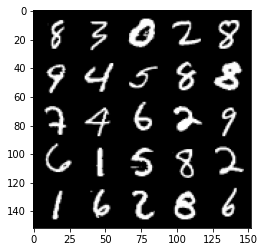

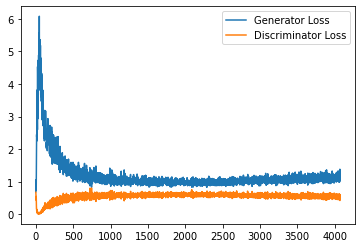

Step 82000: Generator loss: 1.1049876346588134, discriminator loss: 0.5459344416856766


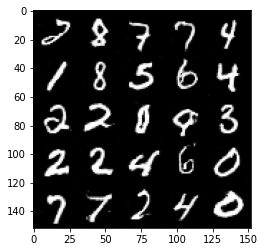

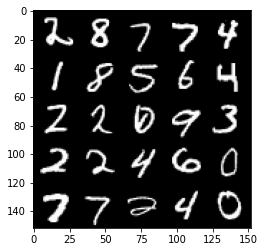

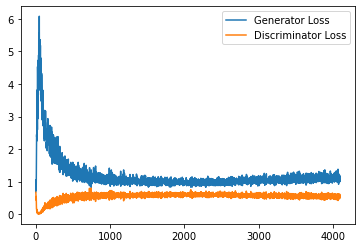

Step 82500: Generator loss: 1.1340715628862381, discriminator loss: 0.5477345123291015


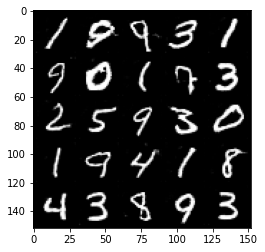

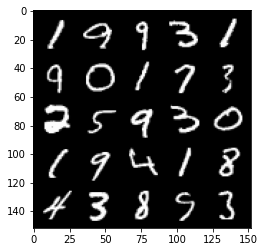

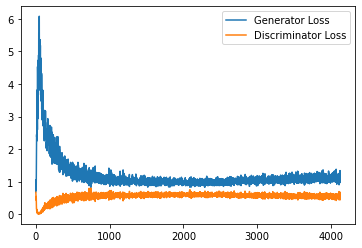

Step 83000: Generator loss: 1.1178717031478882, discriminator loss: 0.5505013311505318


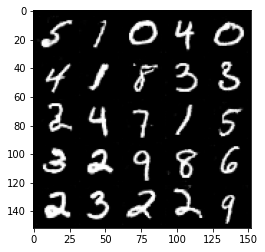

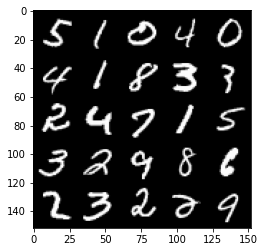

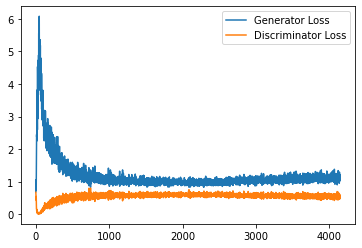

Step 83500: Generator loss: 1.1243565936088562, discriminator loss: 0.5482310670614242


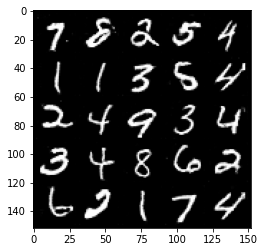

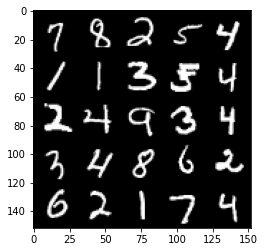

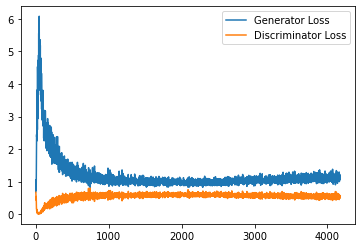

Step 84000: Generator loss: 1.1256031589508058, discriminator loss: 0.544129119515419


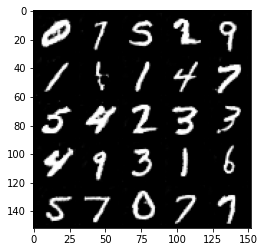

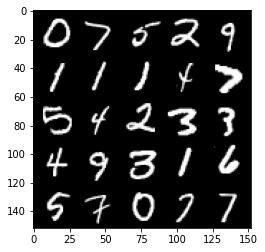

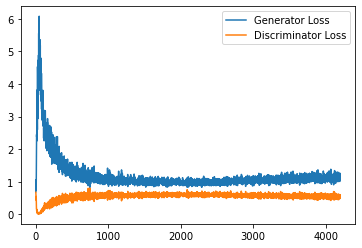

Step 84500: Generator loss: 1.1640049741268157, discriminator loss: 0.5414191412925721


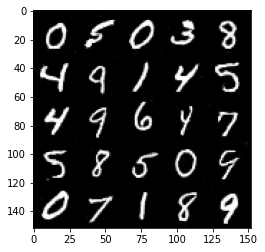

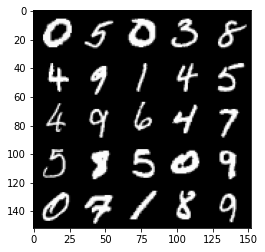

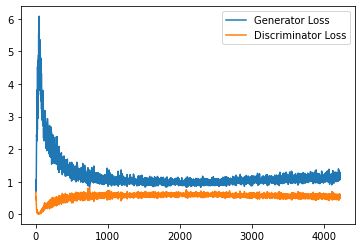

Step 85000: Generator loss: 1.1382996600866317, discriminator loss: 0.5486207957267761


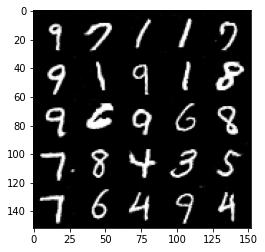

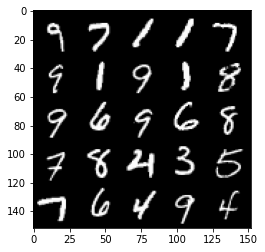

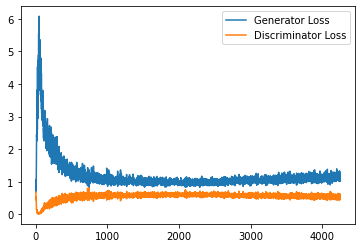

Step 85500: Generator loss: 1.1285685058832169, discriminator loss: 0.5538814417719841


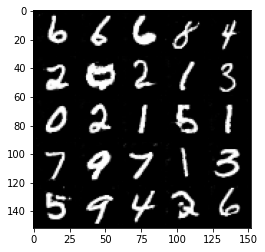

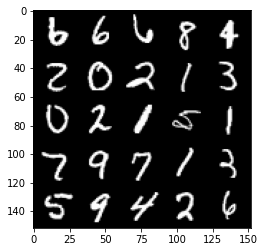

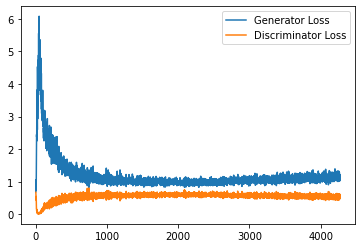

Step 86000: Generator loss: 1.1247076659202575, discriminator loss: 0.5475519341230393


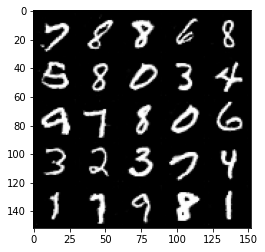

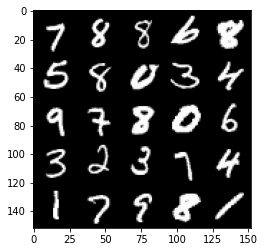

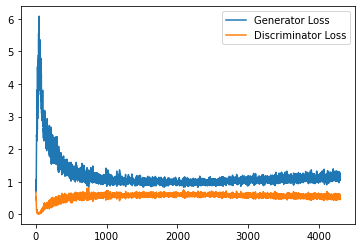

Step 86500: Generator loss: 1.1290671436786652, discriminator loss: 0.545847793340683


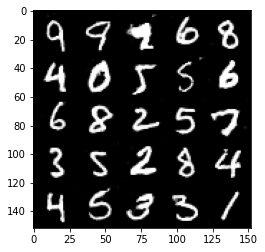

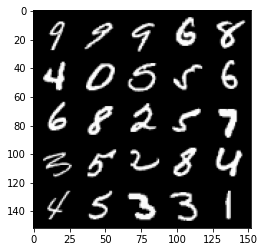

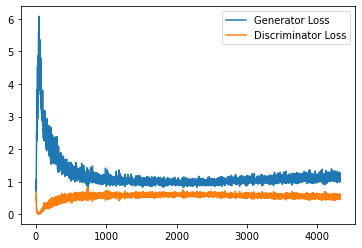

Step 87000: Generator loss: 1.1580141661167145, discriminator loss: 0.5411882625222206


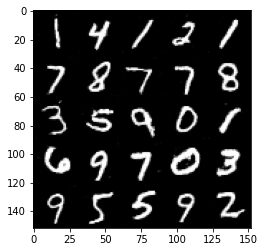

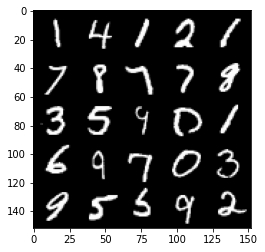

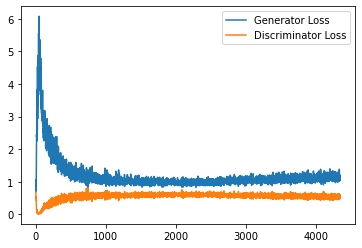

Step 87500: Generator loss: 1.1275940668582916, discriminator loss: 0.5521713325977325


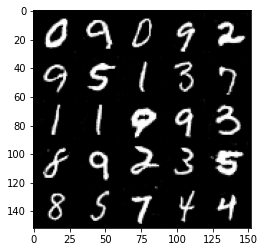

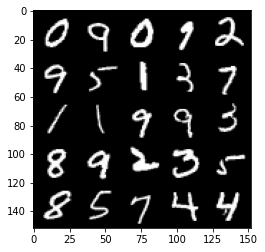

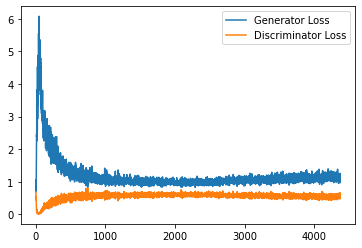

Step 88000: Generator loss: 1.1362115745544434, discriminator loss: 0.5442073143124581


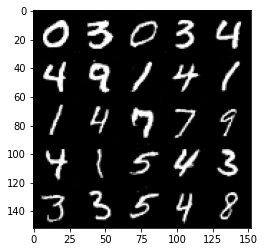

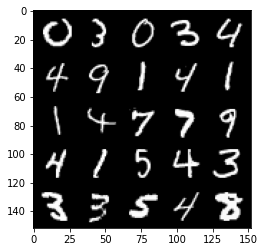

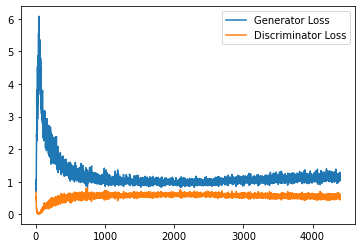

Step 88500: Generator loss: 1.1411496369838714, discriminator loss: 0.5477876248955726


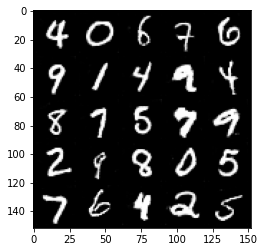

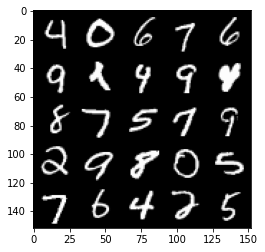

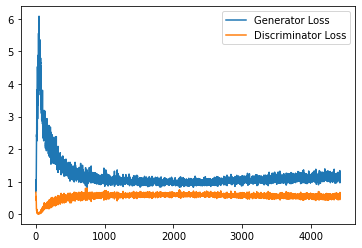

Step 89000: Generator loss: 1.1282748243808747, discriminator loss: 0.5524444959759712


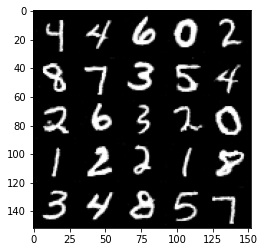

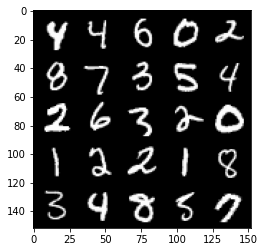

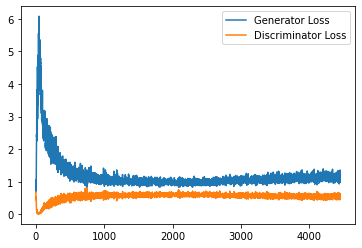

Step 89500: Generator loss: 1.1348109325170517, discriminator loss: 0.5485154314041137


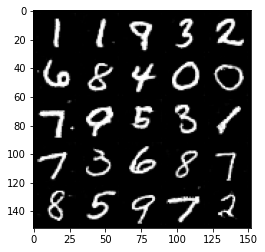

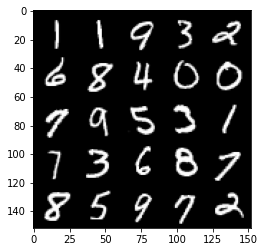

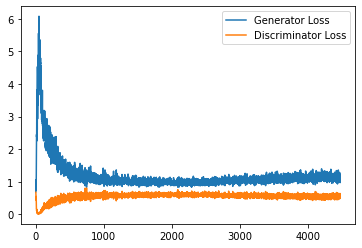

Step 90000: Generator loss: 1.151713131070137, discriminator loss: 0.5446762210130691


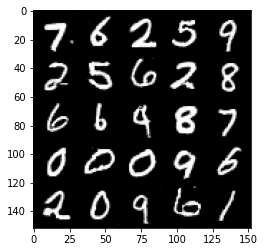

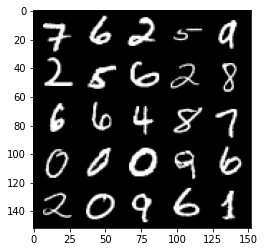

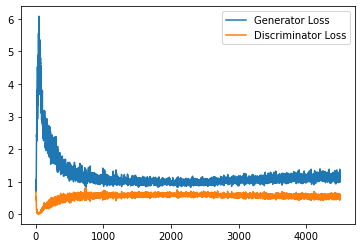

Step 90500: Generator loss: 1.1451400134563445, discriminator loss: 0.5491702612638474


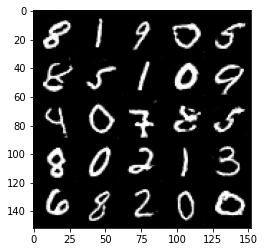

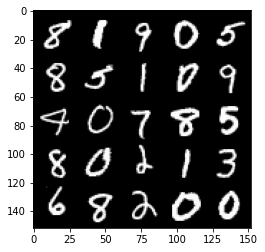

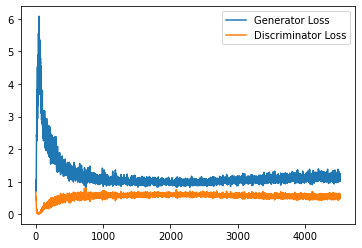

Step 91000: Generator loss: 1.1418541095256804, discriminator loss: 0.5506357743740081


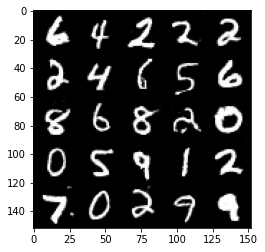

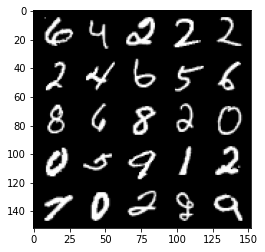

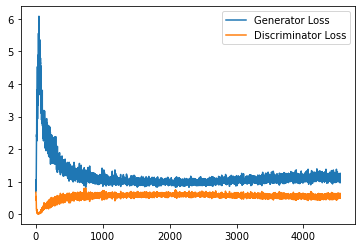

Step 91500: Generator loss: 1.1430881143808365, discriminator loss: 0.5429352712035179


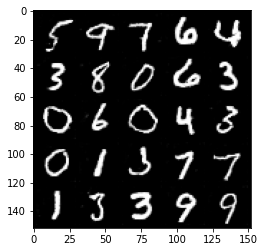

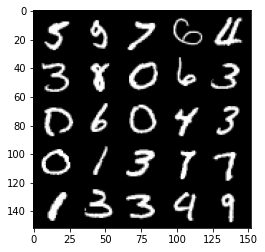

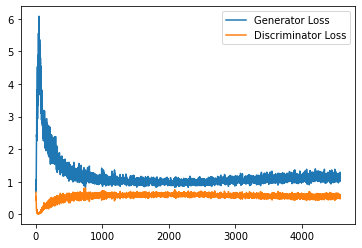

Step 92000: Generator loss: 1.156888611793518, discriminator loss: 0.5442003520727158


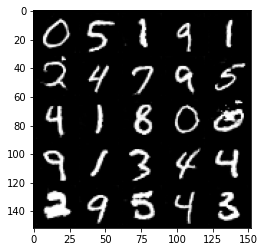

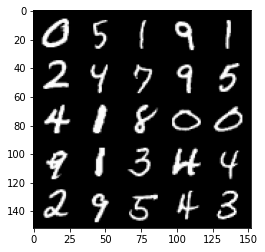

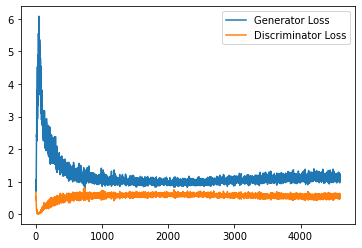

Step 92500: Generator loss: 1.1397951385974885, discriminator loss: 0.5468174304962158


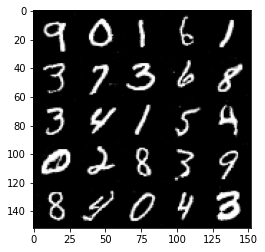

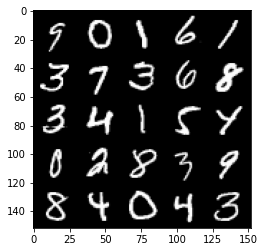

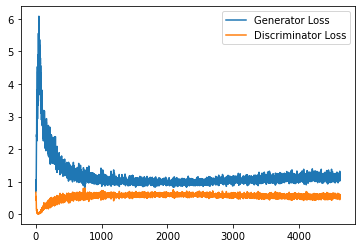

Step 93000: Generator loss: 1.157532481789589, discriminator loss: 0.5491636642217637


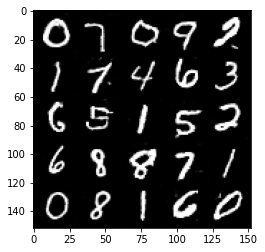

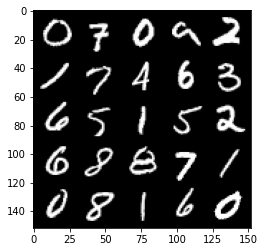

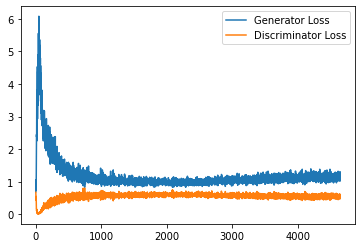

Step 93500: Generator loss: 1.1298215951919555, discriminator loss: 0.5500430663228035


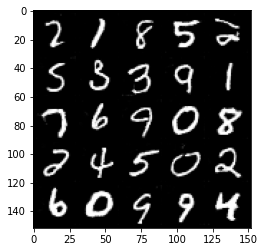

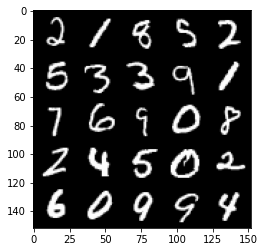

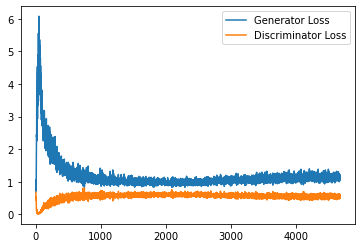

In [127]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()